# MTH3302 – Méthodes probabilistes et statistiques pour I.A.
## Équipe E
### Polytechnique Montréal  

---

## Projet H2025  
### Prédiction de la qualité des vins  

---

### Contexte  
L’évaluation de la qualité d’un vin repose sur plusieurs critères. Les œnologues s’appuient sur des propriétés telles que l’acidité, la niveau en alcool, le sucre résiduel ou encore le pH pour estimer la qualité d’un vin. Toutefois, ces évaluations ne sont pas toujours strictement objectives, car elles peuvent varier selon les préférences individuelles et les conditions de dégustation.

Dans ce projet, nous cherchons à prédire la qualité d’un vin à partir de ses caractéristiques, en utilisant des techniques d’apprentissage automatique.

---

### Objectif  
L’objectif principal est de construire des modèles prédictifs capables d’estimer la note de qualité d’un vin rouge ou blanc sur une échelle de 0 à 10, en se basant uniquement sur les données fournies. Nous évaluerons les performances de différents modèles (linéaires, non linéaires, et de type arbre) en utilisant l’erreur quadratique moyenne (RMSE) comme mesure d’évaluation.

---

### Données utilisées  
Les données proviennent utilisées sont les suivantes: 
- `train.csv` : Ensemble d’entraînement avec les caractéristiques chimiques (comme l’acidité volatile, la densité, l’alcool, etc.) et la note de qualité attribuée par des dégustateurs.  
- `test.csv` : Ensemble de test avec les mêmes caractéristiques chimiques, sans la note de qualité (à prédire).

---


# Chargement des données

Importation des libraires utilisées dans le calpin

In [74]:
using Gadfly, CSV, DataFrames, Statistics, CategoricalArrays, StatsModels, IJulia, StatsBase, Random, MLJ, StatsPlots, Plots, MLJBase, GLM, PrettyTables
const RandomForestRegressor = @load RandomForestRegressor pkg=DecisionTree verbosity=0
const RandomForestClassifier = @load RandomForestClassifier pkg=DecisionTree verbosity=0
const XGBoostRegressor = @load XGBoostRegressor pkg=XGBoost verbosity=0
const RidgeRegressor = @load RidgeRegressor pkg=MLJLinearModels verbosity=0
const LinearRegressor = @load LinearRegressor pkg=MLJLinearModels verbosity=0
const LassoRegressor = @load LassoRegressor pkg=MLJLinearModels verbosity=0;

### Données d'entrainement

In [75]:
train = CSV.read("train.csv", DataFrame, missingstring="NA")
display(first(train, 5))
println("Nombre de lignes : ", nrow(train))

Row,type,alcool,sulphites,pH,densite,chlorure,sucre_residuel,acide_citrique,acidite_volatile,acidite_non_volatile,dioxyde_souffre_total,dioxyde_souffre_libre,qualite
,String7?,Float64?,Float64,Float64,Float64?,Float64,Float64?,Float64,Float64,Float64,Float64,Float64,Int64
1,missing,12.2,0.49,3.22,0.99198,0.058,missing,0.27,0.3,6.4,151.0,27.0,6
2,blanc,8.9,0.47,3.16,missing,0.052,7.6,0.49,0.25,6.1,226.0,67.0,5
3,missing,10.9,0.45,3.11,0.99469,0.039,10.2,0.28,0.18,6.7,115.0,29.0,7
4,missing,9.6,0.44,3.04,0.9952,0.054,6.7,0.44,0.31,6.7,160.0,29.0,5
5,missing,missing,0.49,3.2,0.9938,0.025,5.7,0.37,0.17,7.0,111.0,29.0,6


Nombre de lignes : 5197


### Données de test

In [76]:
test = CSV.read("test.csv", DataFrame, missingstring="NA")
display(first(test, 5))
println("Nombre de lignes : ", nrow(test))

Row,type,alcool,sulphites,pH,densite,chlorure,sucre_residuel,acide_citrique,acidite_volatile,acidite_non_volatile,dioxyde_souffre_total,dioxyde_souffre_libre
,String7?,Float64?,Float64,Float64,Float64?,Float64,Float64?,Float64,Float64,Float64,Float64,Float64
1,missing,missing,0.68,3.49,0.99655,0.082,1.8,0.19,0.55,7.4,34.0,15.0
2,missing,missing,0.43,3.32,0.9914,0.055,1.3,0.21,0.29,6.0,168.0,42.0
3,blanc,10.6,0.43,3.17,0.9959,0.045,7.1,0.42,0.28,8.0,169.0,41.0
4,missing,10.8,0.55,3.2,0.99296,0.038,1.5,0.29,0.32,7.3,144.0,32.0
5,missing,missing,0.83,3.21,0.98746,0.036,1.9,0.18,0.455,5.0,106.0,33.0


Nombre de lignes : 1300


# 1. Pré-traitement des données

Commencons par analyser la distribution de certaines variables numériques présentant des valeurs manquantes dans l’ensemble d’entraînement, notamment l’alcool, la densité et le sucre résiduel.
Les histogrammes permettent d’avoir un aperçu de la répartition des données ayant des valeurs manquantes, ce qui est essentiel lorsque l'on devra passer à l'imputation ou à la normalisation de celles-ci. 


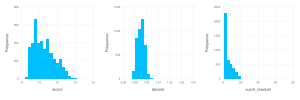

In [77]:
p1 = Gadfly.plot(train, x=:alcool, Geom.histogram(bincount=20), Guide.ylabel("Fréquence"))
p2 = Gadfly.plot(train, x=:densite, Geom.histogram(bincount=20),Guide.ylabel("Fréquence"))
p3 = Gadfly.plot(train, x=:sucre_residuel, Geom.histogram(bincount=20), Guide.ylabel("Fréquence"))

set_default_plot_size(30cm, 10cm)
display(hstack(p1, p2, p3))

On observe que la variable `alcool` suit une distribution légèrement asymétrique vers la droite, avec une majorité des valeurs entre 9 et 12. Cela suggère que l’imputation devrait tenir compte de cette asymétrie, par exemple à l’aide d’un modèle de régression plutôt que d’une simple moyenne.

La variable `densite` est beaucoup plus concentrée autour d’une valeur centrale, avec une forme quasi normale. Une imputation par moyenne ou régression donnerait ici des résultats très similaires.

En revanche, la variable `sucre_residuel` est fortement asymétrique, avec une majorité écrasante de valeurs proches de zéro et quelques valeurs extrêmes au-delà de 20. Dans ce cas, la médiane est souvent plus appropriée pour éviter de biaiser l’imputation à cause des outliers.

Ces observations motivent le choix d’utiliser des méthodes d’imputation différentes selon la variable : médiane pour `sucre_residuel`, et modèles prédictifs pour `alcool` et `densite`.

## 1.1 Imputation des variables manquantes

L'imputation des valeurs manquantes dans le jeu de test suivra le même processus que pour les données d'entraînement, puisque les mêmes variables explicatives (`sucre_residuel`, `densite`, `type` et `alcool`) contiennent des valeurs manquantes. Les variables commençant ou finissant en `train` concerne le jeu de données d’entraînement et celles en `test` concernent le jeu de test.

In [78]:
# Créer les indicateurs de valeurs manquantes
train.alcool_missing = ismissing.(train.alcool)
train.densite_missing = ismissing.(train.densite)
train.sucre_missing = ismissing.(train.sucre_residuel)

test.alcool_missing = ismissing.(test.alcool)
test.densite_missing = ismissing.(test.densite)
test.sucre_missing = ismissing.(test.sucre_residuel)

train_imputed = copy(train);
test_imputed = copy(test);

describe(train_imputed)

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Int64,Type
1,type,,blanc,,rouge,3897,"Union{Missing, String7}"
2,alcool,10.4876,8.0,10.3,14.9,1004,"Union{Missing, Float64}"
3,sulphites,0.53336,0.22,0.51,2.0,0,Float64
4,pH,3.21835,2.74,3.21,4.01,0,Float64
5,densite,0.994694,0.98711,0.99489,1.03898,1093,"Union{Missing, Float64}"
6,chlorure,0.0562324,0.009,0.047,0.611,0,Float64
7,sucre_residuel,5.41243,0.6,2.9,65.8,1021,"Union{Missing, Float64}"
8,acide_citrique,0.319992,0.0,0.31,1.66,0,Float64
9,acidite_volatile,0.341575,0.08,0.29,1.58,0,Float64


On voit donc que les variables `sucre_residuel`, `densite`, `type` et `alcool` possède tous des missings. Voyons combien de pourcent cela représente dans les données.

In [79]:
total_rows = nrow(train_imputed)
resumé_missing = DataFrame(
    colonne = String[], 
    nb_missing = Int[], 
    pourcentage = Float64[]
)

# Remplir le tableau avec les colonnes ayant des missing
for col in names(train_imputed)
    nb = sum(ismissing, train[!, col])
    if nb > 0
        push!(resumé_missing, (String(col), nb, 100 * nb / total_rows))
    end
end

# Trier par pourcentage décroissant
sort!(resumé_missing, :pourcentage, rev=true)

# Afficher le tableau
display(resumé_missing)

Row,colonne,nb_missing,pourcentage
,String,Int64,Float64
1,type,3897,74.9856
2,densite,1093,21.0314
3,sucre_residuel,1021,19.6459
4,alcool,1004,19.3188


La variable `type` est celle qui contient le plus de valeurs manquantes (environ 75 %), ce qui est dommage puisque la distinction entre vin rouge et vin blanc est cruciale : ces deux types présentent des caractéristiques chimiques très différentes.

Par ailleurs, selon plusieurs sources spécialisées en œnologie, la variable `alcool` est fortement corrélée à la qualité perçue d’un vin. Il est donc essentiel de bien l’imputer.

Pour ces raisons, nous avons choisi d’imputer les variables `type`, `alcool` et `densite` à l’aide de modèles prédictifs (comme `RandomForestRegressor`), plutôt que de nous contenter d’une simple moyenne ou médiane. Ce choix permet de mieux capturer les relations non linéaires entre les variables.

La variable `sucre_residuel`, quant à elle, présente une distribution fortement asymétrique. Nous avons donc jugé qu’une imputation par médiane était plus appropriée dans ce cas.

Note importante : une bonne estimation de `alcool` dépend d’une bonne estimation de `densite`. C’est pourquoi l’imputation est effectuée dans l’ordre suivant :

1. `sucre_residuel` — **Médiane**
2. `densite` — **RandomForestRegressor**
3. `alcool` — **RandomForestRegressor**
4. `type` — **RandomForestRegressor**

N.B. : Nous avons choisi d’utiliser un modèle `RandomForestRegressor` pour imputer les variables `alcool`, `type` et `densite`, car ce sont trois variables complexes, fortement influencées par plusieurs autres caractéristiques chimiques du vin. Par exemple, `densite` dépend de façon non linéaire de variables comme le sucre résiduel, l’alcool et l’acidité. De même, `alcool` est corrélé à plusieurs facteurs qui interagissent entre eux. Un modèle de régression linéaire risquerait de mal capter ces relations, tandis que les forêts aléatoires permettent de modéliser efficacement ces dépendances complexes sans supposer de relation linéaire entre les variables. De plus, étant donnée que la prédiction de ces variables n'est pas l’objectif principal de ce projet, nous avons moins étudié ces variables explicatives et nous sommes permis d'utiliser un modèle plus complexe en explorant un peu moins la distribution de ces variables par rapport aux autres.

### 1.1.1 Imputation de Sucre Résiduel

In [80]:
# Calculer la médiane de sucre_residuel (sur les valeurs non manquantes)
median_sucre_train = median(skipmissing(train_imputed.sucre_residuel))
median_sucre_test = median(skipmissing(test_imputed.sucre_residuel))

# Créer un vecteur de la même longueur que le nombre de lignes où sucre_missing est true
num_missing_train = sum(train_imputed.sucre_missing)
num_missing_test = sum(test_imputed.sucre_missing)
median_sucre_vector_train = fill(median_sucre_train, num_missing_train)
median_sucre_vector_test = fill(median_sucre_test, num_missing_test)

# Imputer les valeurs manquantes
train_imputed[train_imputed.sucre_missing, :sucre_residuel] = median_sucre_vector_train
test_imputed[test_imputed.sucre_missing, :sucre_residuel] = median_sucre_vector_test
# Convertir la colonne sucre_residuel en Vector{Float64}
train_imputed.sucre_residuel = convert(Vector{Float64}, train_imputed.sucre_residuel)
test_imputed.sucre_residuel = convert(Vector{Float64}, test_imputed.sucre_residuel)

# Supprimer l'indicateur sucre_missing
# select!(train_imputed, Not(:sucre_missing))

# Vérifier
println("Nombre de valeurs manquantes dans sucre_residuel après imputation : ", sum(ismissing.(train_imputed.sucre_residuel)))
describe(test_imputed)

Nombre de valeurs manquantes dans sucre_residuel après imputation : 0


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Int64,Type
1,type,,blanc,,rouge,975,"Union{Missing, String7}"
2,alcool,10.4637,8.4,10.2,14.0,263,"Union{Missing, Float64}"
3,sulphites,0.522908,0.25,0.5,1.95,0,Float64
4,pH,3.21911,2.72,3.2,3.9,0,Float64
5,densite,0.994637,0.98746,0.9948,1.0103,251,"Union{Missing, Float64}"
6,chlorure,0.05524,0.012,0.047,0.464,0,Float64
7,sucre_residuel,4.86623,0.7,3.1,31.6,0,Float64
8,acide_citrique,0.3132,0.0,0.3,0.91,0,Float64
9,acidite_volatile,0.332035,0.085,0.29,1.13,0,Float64


### 1.1.2 Imputation de Densité

In [81]:
# Séparer les données
group_densite_present_train = train_imputed[.!train_imputed.densite_missing, :]
group_densite_missing_train = train_imputed[train_imputed.densite_missing, :];

group_densite_present_test = test_imputed[.!test_imputed.densite_missing, :]
group_densite_missing_test = test_imputed[test_imputed.densite_missing, :];

In [82]:
features_densite = [:sucre_residuel, :acide_citrique, :acidite_volatile, :acidite_non_volatile, :dioxyde_souffre_total, :sulphites, :chlorure, :pH]

# Préparer les données d'entraînement
X_train_densite = group_densite_present_train[:, features_densite]
y_train_densite = group_densite_present_train.densite
y_train_densite = convert(Vector{Float64}, y_train_densite)

X_test_densite = group_densite_present_test[:, features_densite]
y_test_densite = group_densite_present_test.densite
y_test_densite = convert(Vector{Float64}, y_test_densite)

describe(X_train_densite)

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,sucre_residuel,4.7081,0.6,2.9,65.8,0,Float64
2,acide_citrique,0.321574,0.0,0.31,1.66,0,Float64
3,acidite_volatile,0.342535,0.08,0.3,1.58,0,Float64
4,acidite_non_volatile,7.24296,3.8,7.0,15.9,0,Float64
5,dioxyde_souffre_total,114.041,6.0,117.0,440.0,0,Float64
6,sulphites,0.532878,0.23,0.51,2.0,0,Float64
7,chlorure,0.0561133,0.009,0.047,0.611,0,Float64
8,pH,3.21615,2.74,3.21,4.01,0,Float64


In [83]:
# Créer une instance du modèle
model_densite = RandomForestRegressor(n_trees=200, max_depth=10)

# Créer une machine
mach_densite_train = machine(model_densite, X_train_densite, y_train_densite)
mach_densite_test = machine(model_densite, X_test_densite, y_test_densite)

# Entraîner le modèle
fit!(mach_densite_train)
fit!(mach_densite_test)
println("Modèle entraîné pour prédire densité !")

[ Info: Training machine(RandomForestRegressor(max_depth = 10, …), …).
[ Info: Training machine(RandomForestRegressor(max_depth = 10, …), …).


Modèle entraîné pour prédire densité !


In [84]:
# Préparer les données pour les prédictions
X_missing_densite_train = group_densite_missing_train[:, features_densite]
X_missing_densite_test = group_densite_missing_test[:, features_densite]

# Prédire
densite_pred_train = MLJ.predict(mach_densite_train, X_missing_densite_train)
densite_pred_test = MLJ.predict(mach_densite_test, X_missing_densite_test)

# Imputer les valeurs manquantes
train_imputed[train_imputed.densite_missing, :densite] = densite_pred_train
test_imputed[test_imputed.densite_missing, :densite] = densite_pred_test
# Convertir la colonne sucre_residuel en Vector{Float64}
train_imputed.densite = convert(Vector{Float64}, train_imputed.densite)
test_imputed.densite = convert(Vector{Float64}, test_imputed.densite)

# Supprimer l'indicateur densite_missing
select!(train_imputed, Not(:densite_missing));
select!(test_imputed, Not(:densite_missing));
println("Nombre de valeurs manquantes dans densité après imputation : ", sum(ismissing.(train_imputed.densite)))

Nombre de valeurs manquantes dans densité après imputation : 0


In [85]:
describe(test_imputed)

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Int64,Type
1,type,,blanc,,rouge,975,"Union{Missing, String7}"
2,alcool,10.4637,8.4,10.2,14.0,263,"Union{Missing, Float64}"
3,sulphites,0.522908,0.25,0.5,1.95,0,Float64
4,pH,3.21911,2.72,3.2,3.9,0,Float64
5,densite,0.99464,0.98746,0.9948,1.0103,0,Float64
6,chlorure,0.05524,0.012,0.047,0.464,0,Float64
7,sucre_residuel,4.86623,0.7,3.1,31.6,0,Float64
8,acide_citrique,0.3132,0.0,0.3,0.91,0,Float64
9,acidite_volatile,0.332035,0.085,0.29,1.13,0,Float64


### 1.1.3 Imputation de Alcool

In [86]:
# 1. Séparer les groupes
group_alcool_present_train = train_imputed[.!train_imputed.alcool_missing, :]
group_alcool_missing_train = train_imputed[train_imputed.alcool_missing, :]

group_alcool_present_test = test_imputed[.!test_imputed.alcool_missing, :]
group_alcool_missing_test = test_imputed[test_imputed.alcool_missing, :]

# 2. Sélectionner les features pertinentes
features_alcool = [:densite, :sucre_residuel, :acide_citrique, :acidite_volatile, :acidite_non_volatile, 
                   :dioxyde_souffre_total, :sulphites, :chlorure, :pH]

# 3. Construire X et y
X_train_alcool = group_alcool_present_train[:, features_alcool]
y_train_alcool = group_alcool_present_train.alcool
y_train_alcool = convert(Vector{Float64}, y_train_alcool)

X_test_alcool = group_alcool_present_test[:, features_alcool]
y_test_alcool = group_alcool_present_test.alcool
y_test_alcool = convert(Vector{Float64}, y_test_alcool)

# 5. Créer et entraîner le modèle
model_alcool = RandomForestRegressor(n_trees=300, max_depth=10)

mach_alcool_train = machine(model_alcool, X_train_alcool, y_train_alcool)
fit!(mach_alcool_train)
println("Modèle entraîné pour prédire alcool train !")

mach_alcool_test = machine(model_alcool, X_test_alcool, y_test_alcool)
fit!(mach_alcool_test)
println("Modèle entraîné pour prédire alcool test !")

# 6. Prédire sur les lignes manquantes
X_missing_alcool_train = group_alcool_missing_train[:, features_alcool]
alcool_pred_train = MLJ.predict(mach_alcool_train, X_missing_alcool_train)

X_missing_alcool_test = group_alcool_missing_test[:, features_alcool]
alcool_pred_test = MLJ.predict(mach_alcool_test, X_missing_alcool_test)

# 7. Imputer les valeurs manquantes
train_imputed[train_imputed.alcool_missing, :alcool] = alcool_pred_train
test_imputed[test_imputed.alcool_missing, :alcool] = alcool_pred_test

# 8. Convertir la colonne si nécessaire
train_imputed.alcool = convert(Vector{Float64}, train_imputed.alcool)
test_imputed.alcool = convert(Vector{Float64}, test_imputed.alcool)

# 9. Supprimer l'indicateur
select!(train_imputed, Not(:alcool_missing))
select!(test_imputed, Not(:alcool_missing))

# 10. Vérifier
println("Nombre de valeurs manquantes dans alcool après imputation : ", sum(ismissing.(train_imputed.alcool)))
describe(train_imputed)

[ Info: Training machine(RandomForestRegressor(max_depth = 10, …), …).


Modèle entraîné pour prédire alcool train !


[ Info: Training machine(RandomForestRegressor(max_depth = 10, …), …).


Modèle entraîné pour prédire alcool test !
Nombre de valeurs manquantes dans alcool après imputation : 0


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Int64,Type
1,type,,blanc,,rouge,3897,"Union{Missing, String7}"
2,alcool,10.4943,8.0,10.3,14.9,0,Float64
3,sulphites,0.53336,0.22,0.51,2.0,0,Float64
4,pH,3.21835,2.74,3.21,4.01,0,Float64
5,densite,0.994726,0.98711,0.9949,1.03898,0,Float64
6,chlorure,0.0562324,0.009,0.047,0.611,0,Float64
7,sucre_residuel,4.91884,0.6,2.9,65.8,0,Float64
8,acide_citrique,0.319992,0.0,0.31,1.66,0,Float64
9,acidite_volatile,0.341575,0.08,0.29,1.58,0,Float64


### 1.1.4 Imputation du Type

In [87]:
train_imputed.type = categorical(train_imputed.type)
test_imputed.type = categorical(test_imputed.type)

# Séparer les observations où type est connu
data_with_type_train = train_imputed[.!ismissing.(train_imputed.type), :]
data_with_type_test = test_imputed[.!ismissing.(test_imputed.type), :]

# Créer des sous-ensembles pour les rouges et les blancs
rouges_train = data_with_type_train[data_with_type_train.type .== "rouge", :]
blancs_train = data_with_type_train[data_with_type_train.type .== "blanc", :]

rouges_test = data_with_type_test[data_with_type_test.type .== "rouge", :]
blancs_test = data_with_type_test[data_with_type_test.type .== "blanc", :]

# Par exemple, pour dioxyde_souffre_total
println("Nombre de vins rouge disponible dans le dataset : ", nrow(rouges_train))
println("Nombre de vins blancs disponible dans le dataset : ", nrow(blancs_train))

Nombre de vins rouge disponible dans le dataset : 341
Nombre de vins blancs disponible dans le dataset : 959


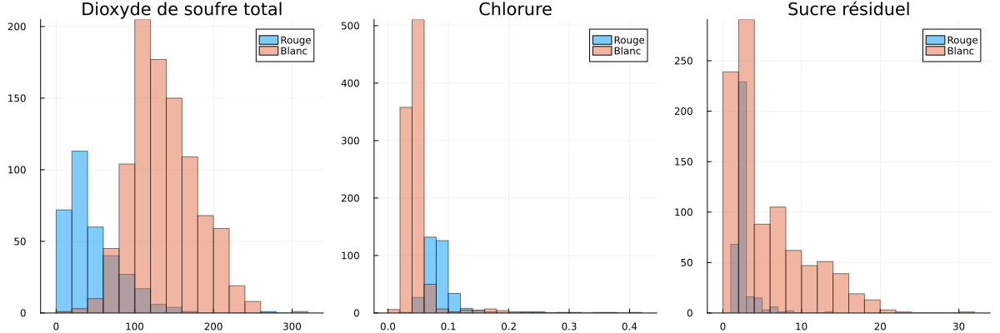

In [88]:
# 1. Créer chaque subplot individuellement
p1 = histogram(rouges_train.dioxyde_souffre_total, bins=20, label="Rouge", alpha=0.5, title="Dioxyde de soufre total")
histogram!(p1, blancs_train.dioxyde_souffre_total, bins=20, label="Blanc", alpha=0.5)

p2 = histogram(rouges_train.chlorure, bins=20, label="Rouge", alpha=0.5, title="Chlorure")
histogram!(p2, blancs_train.chlorure, bins=20, label="Blanc", alpha=0.5)

p3 = histogram(rouges_train.sucre_residuel, bins=20, label="Rouge", alpha=0.5, title="Sucre résiduel")
histogram!(p3, blancs_train.sucre_residuel, bins=20, label="Blanc", alpha=0.5)

# 2. Affichage côte à côte
Plots.plot(p1, p2, p3, layout=(1,3), size=(1200,400))

On observe que certaines variables, souvent influencées par le type de vin (blanc ou rouge), présentent des distributions très différentes selon qu’il s’agit d’un vin blanc ou d’un vin rouge.  
Cela renforce l'importance de bien prédire la variable `type`, puisqu’elle est fortement liée aux caractéristiques chimiques du vin.

In [89]:
data_with_type_train = dropmissing(train_imputed, :type)
data_with_type_test = dropmissing(test_imputed, :type)

# Données à prédire (type manquant)
data_missing_type_train = train_imputed[ismissing.(train_imputed.type), :]
data_missing_type_test = test_imputed[ismissing.(test_imputed.type), :]

# Définir les features
features = [:alcool, :sucre_residuel, :acide_citrique, :acidite_volatile, :acidite_non_volatile,
            :dioxyde_souffre_total, :sulphites, :chlorure, :pH, :sucre_missing, :densite]

# Assurer que sucre_missing est catégorisé
train_imputed.sucre_missing = categorical(train_imputed.sucre_missing)
test_imputed.sucre_missing = categorical(test_imputed.sucre_missing)

# X et y pour entraînement (seulement où type est connu)
X_train = data_with_type_train[:, features]
y_train = categorical(data_with_type_train.type)

X_test = data_with_type_test[:, features]
y_test = categorical(data_with_type_test.type);

# X pour prédiction
X_missing_train = data_missing_type_train[:, features]
X_missing_test = data_missing_type_test[:, features];

In [90]:
MLJBase.schema(X_train)

┌───────────────────────┬────────────┬─────────┐
│ names                 │ scitypes   │ types   │
├───────────────────────┼────────────┼─────────┤
│ alcool                │ Continuous │ Float64 │
│ sucre_residuel        │ Continuous │ Float64 │
│ acide_citrique        │ Continuous │ Float64 │
│ acidite_volatile      │ Continuous │ Float64 │
│ acidite_non_volatile  │ Continuous │ Float64 │
│ dioxyde_souffre_total │ Continuous │ Float64 │
│ sulphites             │ Continuous │ Float64 │
│ chlorure              │ Continuous │ Float64 │
│ pH                    │ Continuous │ Float64 │
│ sucre_missing         │ Count      │ Bool    │
│ densite               │ Continuous │ Float64 │
└───────────────────────┴────────────┴─────────┘


In [91]:
# Créer une instance du modèle
model = RandomForestClassifier(n_trees=200, max_depth=10)

# Créer une machine
mach_train = machine(model, X_train, y_train; scitype_check_level=0)
fit!(mach_train)

mach_test = machine(model, X_test, y_test; scitype_check_level=0)
fit!(mach_test)

# Vérifier que l'entraînement a réussi
println("Modèle entraîné avec succès pour prédire type !")

[ Info: Training machine(RandomForestClassifier(max_depth = 10, …), …).


Modèle entraîné avec succès pour prédire type !


[ Info: Training machine(RandomForestClassifier(max_depth = 10, …), …).


In [92]:
println("Nombre de valeurs manquantes dans type avant imputation : ", sum(ismissing.(train_imputed.type)))

# Prédictions sur les lignes manquantes
y_pred_train = predict_mode(mach_train, X_missing_train)
train_imputed[ismissing.(train_imputed.type), :type] = y_pred_train

y_pred_test = predict_mode(mach_test, X_missing_test)
test_imputed[ismissing.(test_imputed.type), :type] = y_pred_test

disallowmissing!(train_imputed, :type)
disallowmissing!(test_imputed, :type)

println("Nombre de valeurs manquantes dans type après imputation : ", sum(ismissing.(train_imputed.type)))

rouges = sum(!ismissing(row.type) && row.type == "rouge" for row in eachrow(train_imputed))
blancs = sum(!ismissing(row.type) && row.type == "blanc" for row in eachrow(train_imputed))

println("Vins rouges après imputation : ", rouges)
println("Vins blancs après imputation : ", blancs)

Nombre de valeurs manquantes dans type avant imputation : 3897
Nombre de valeurs manquantes dans type après imputation : 0
Vins rouges après imputation : 1292
Vins blancs après imputation : 3905


## 1.2 Séparation du jeu de données

Selon les résulats obtenus à la section **1.1.4 Imputation du type**, il est clair que les caractéristiques chimiques du vin, comme le surcre résiduel, le chlorure et le dioxyde de soufre total, varient considérablement selon le type de vin. Nous avons donc choisi de séparer le jeu de données en deux sous-ensembles distincts : un pour le vin rouge et un pour le vin blanc

En séparant les données, cela nous permet de mieux adapter les modèles de prédiction à chaque type de vin et d'améliorer leur précision


In [93]:
train_imputed[!, :qualite] = Float64.(train_imputed[!, :qualite])

red_wines = filter(row -> row.type == "rouge", train_imputed)
println("Nombre de vins rouges : ", nrow(red_wines))

# Séparer les vins blancs
white_wines = filter(row -> row.type == "blanc", train_imputed)
println("Nombre de vins blancs : ", nrow(white_wines))
first(red_wines, 5)

Nombre de vins rouges : 1292
Nombre de vins blancs : 3905


Row,type,alcool,sulphites,pH,densite,chlorure,sucre_residuel,acide_citrique,acidite_volatile,acidite_non_volatile,dioxyde_souffre_total,dioxyde_souffre_libre,qualite,sucre_missing
,Cat…,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Cat…
1,rouge,11.2,0.54,3.45,0.99402,0.078,1.7,0.09,0.48,6.1,30.0,18.0,6.0,false
2,rouge,9.5,0.78,3.35,0.9958,0.085,1.5,0.04,0.5,6.9,49.0,19.0,5.0,false
3,rouge,9.70779,0.66,3.24,0.9968,0.118,2.0,0.56,0.745,8.0,134.0,30.0,5.0,false
4,rouge,9.8,0.48,3.17,0.9942,0.07,2.9,0.06,0.62,7.1,12.0,5.0,5.0,true
5,rouge,10.0,0.6,3.32,0.9965,0.077,2.4,0.0,0.64,7.5,29.0,18.0,6.0,false


In [94]:
# Vins rouges
y_red = red_wines.qualite
X_red = DataFrames.select(red_wines, Not([:qualite, :sucre_missing, :type]))

# Vins blancs
y_white = white_wines.qualite
X_white = DataFrames.select(white_wines, Not([:qualite, :sucre_missing, :type]));

# 2. Analyse exploratoire des données
Nous allons maintenant explorer les différentes distributions des données et corrélations afin de mieux comprendre la structure et les relations possibles (linéaire ou non linéaire) avec la qualité du vin (variable cible).

Nous allons débuter par une analyse des distributions des données (**2.1**), puis nous allons examiner plus en détail les différentes corrélations observées entre les variables explicatives et la qualité du vin (**2.2**).

## 2.1 Analyse de la distribution des données


### 2.1.1 Distribution initiale des données

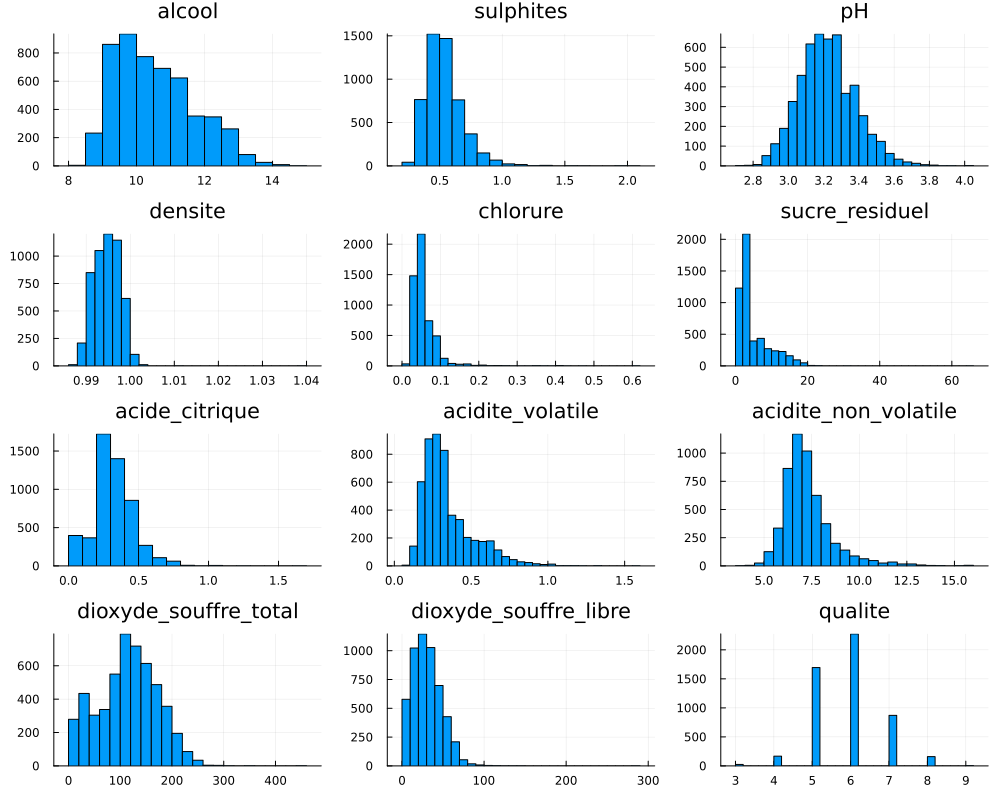

In [95]:
X = DataFrames.select(train_imputed, Not(:sucre_missing))
numerical_cols = names(X)[[eltype(X[!, col]) <: Number for col in names(X)]]

plots = [Plots.histogram(X[!, col], title=col, bins=30, legend=false) for col in numerical_cols]

n = length(plots)
nrows = ceil(Int, sqrt(n))
ncols = ceil(Int, n / nrows)

Plots.plot(plots...; layout=(nrows, ncols), size=(1000, 800))

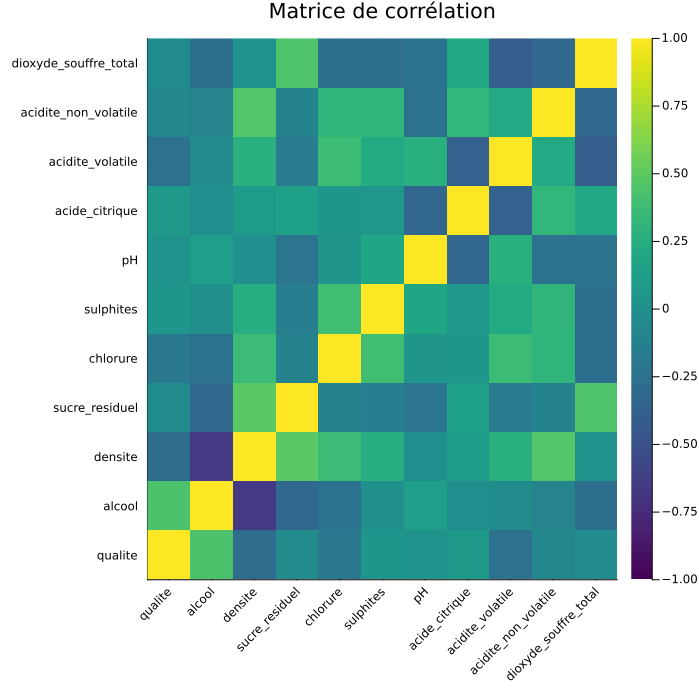

In [96]:
# Liste complète des variables numériques que l'on veut inclure
numeric_vars = [:qualite, :alcool, :densite, :sucre_residuel, :chlorure, 
                :sulphites, :pH, :acide_citrique, :acidite_volatile, 
                :acidite_non_volatile, :dioxyde_souffre_total]

# Extraire les colonnes du DataFrame
df_corr = DataFrames.select(train_imputed, numeric_vars)

# Calcul de la matrice de corrélation
corr_matrix = cor(Matrix(df_corr))

# Affichage de la heatmap
heatmap(corr_matrix,
    xticks=(1:length(numeric_vars), string.(numeric_vars)),
    yticks=(1:length(numeric_vars), string.(numeric_vars)),
    c=:viridis,
    title="Matrice de corrélation",
    size=(700,700),
    xrotation=45,
    clim=(-1, 1)
)

Lorsqu'on observe l'ensemble des données sans distinguer le type de vin, les distributions des variables ainsi que la matrice de corrélation apparaissent peu informatives. Les différences entre vins rouges et blancs ont tendance à masquer les relations significatives.

Cela dit, on remarque tout de même que le niveau d’alcool demeure la variable la plus corrélée avec la qualité, et ce, pour les deux types de vins. Vonyons si cette tendance est linéaire ou non.

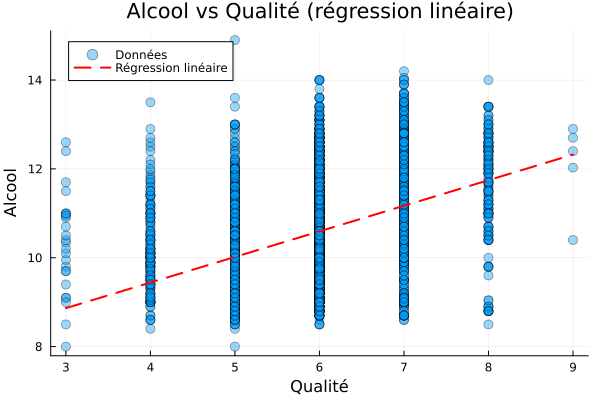

In [97]:
# 1. Préparer les données
df = dropmissing(DataFrames.select(train_imputed, [:qualite, :alcool]))

# 2. Régression linéaire : alcool ~ qualite
lm_model = lm(@formula(alcool ~ qualite), df)

# 3. Prédictions sur une plage de qualité
x_range = collect(minimum(df.qualite):maximum(df.qualite))
df_pred = DataFrame(qualite = x_range)
df_pred.alcool = GLM.predict(lm_model, df_pred)

# 4. Tracer avec Plots
scatter(df.qualite, df.alcool,
    alpha=0.4, markersize=5, label="Données",
    xlabel="Qualité", ylabel="Alcool", title="Alcool vs Qualité (régression linéaire)"
)

plot!(df_pred.qualite, df_pred.alcool,
    linewidth=2, line=:dash, color=:red, label="Régression linéaire"
)

Bien que les données soient assez dispersées pour chaque niveau de qualité, on observe tout de même une tendance générale à la hausse : plus la qualité du vin est élevée, plus sa teneur en alcool tend à être élevée.  
Cela suggère que l’alcool pourrait être un facteur partiellement prédictif de la qualité, mais qu’il ne suffit pas à lui seul à l’expliquer de façon précise.

#### Qualité en fonction du type de vin

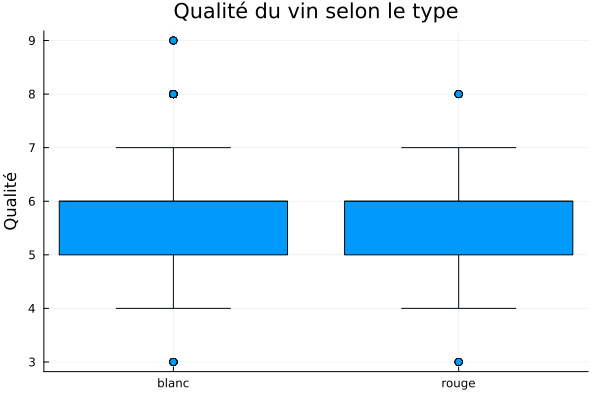

In [98]:
@df train_imputed boxplot(:type, :qualite, title="Qualité du vin selon le type", ylabel="Qualité", legend=false)

On remarque donc que la distribution de la qualité des deux types de vins est très similaire malgré le fait que les vins blancs semble avoir quelques valeurs extrêmes.

### 2.1.2 Distribution des données par type de vin
Passons maintenant à l'analyse de la distribution des données en fonction du type de vin (rouge ou blanc). Cette analyse nous permettra de mieux comprendre les caractéristiques spécifiques à chaque type de vin et d'observer les potentielles diférences entres elles.



#### 2.2.1 Vins blancs

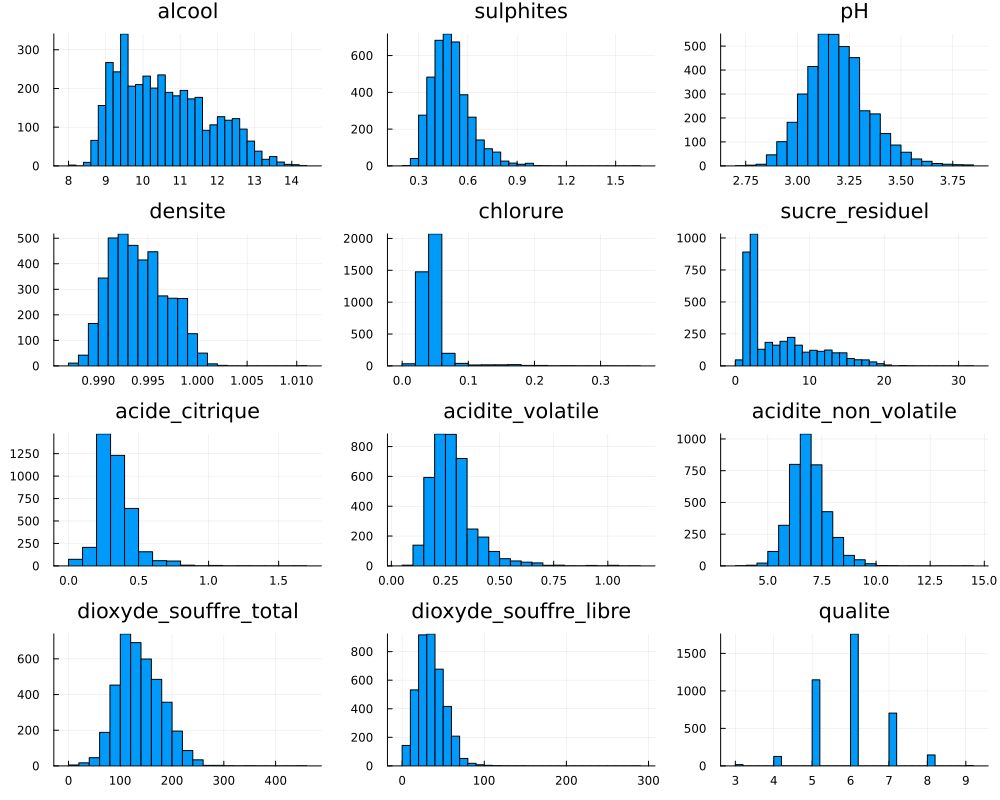

In [99]:
X = DataFrames.select(white_wines, Not(:sucre_missing))
numerical_cols = names(X)[[eltype(X[!, col]) <: Number for col in names(X)]]

plots = [Plots.histogram(X[!, col], title=col, bins=30, legend=false) for col in numerical_cols]

n = length(plots)
nrows = ceil(Int, sqrt(n))
ncols = ceil(Int, n / nrows)

Plots.plot(plots...; layout=(nrows, ncols), size=(1000, 800))

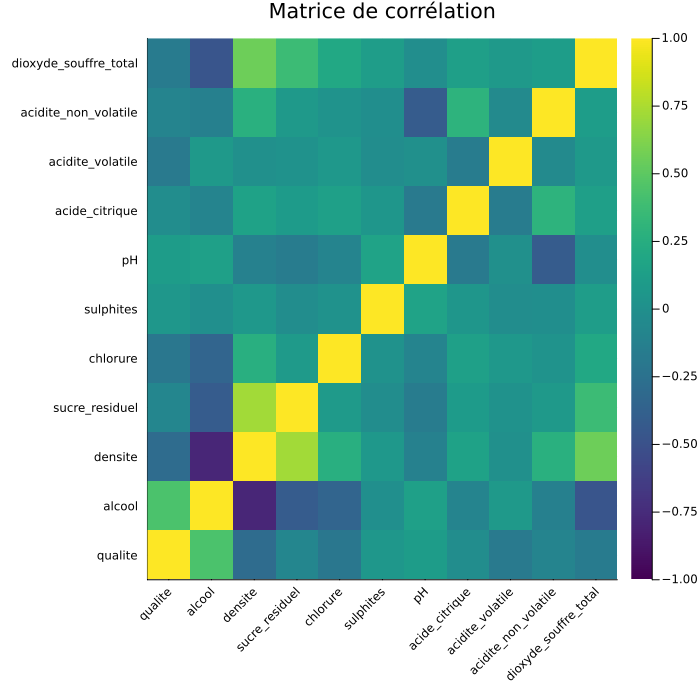

In [100]:
# Liste complète des variables numériques que l'on veux inclure
numeric_vars = [:qualite, :alcool, :densite, :sucre_residuel, :chlorure, 
                :sulphites, :pH, :acide_citrique, :acidite_volatile, 
                :acidite_non_volatile, :dioxyde_souffre_total]

# Extraire les colonnes du DataFrame
df_corr = DataFrames.select(white_wines, numeric_vars)

# Calcul de la matrice de corrélation
corr_matrix = cor(Matrix(df_corr))

# Affichage de la heatmap
heatmap(corr_matrix,
    xticks=(1:length(numeric_vars), string.(numeric_vars)),
    yticks=(1:length(numeric_vars), string.(numeric_vars)),
    c=:viridis,
    title="Matrice de corrélation",
    size=(700,700),
    xrotation=45,
    clim=(-1, 1)
)

La séparation des vins selon leur type permet de faire ressortir des distributions de variables explicatives plus claires, ainsi qu'une matrice de corrélation beaucoup plus lisible et pertinente.

On y observe notamment une forte corrélation entre les variables `sucre_residuel` et `densite`, ce qui s'explique naturellement : la densité d’un liquide dépend directement de la concentration en solutés, notamment en sucre.

Nous vérifierons plus tard si il est nécessaire de retirer certaines variables explicatives afin de ne pas nuire à la performance de certains modèles.

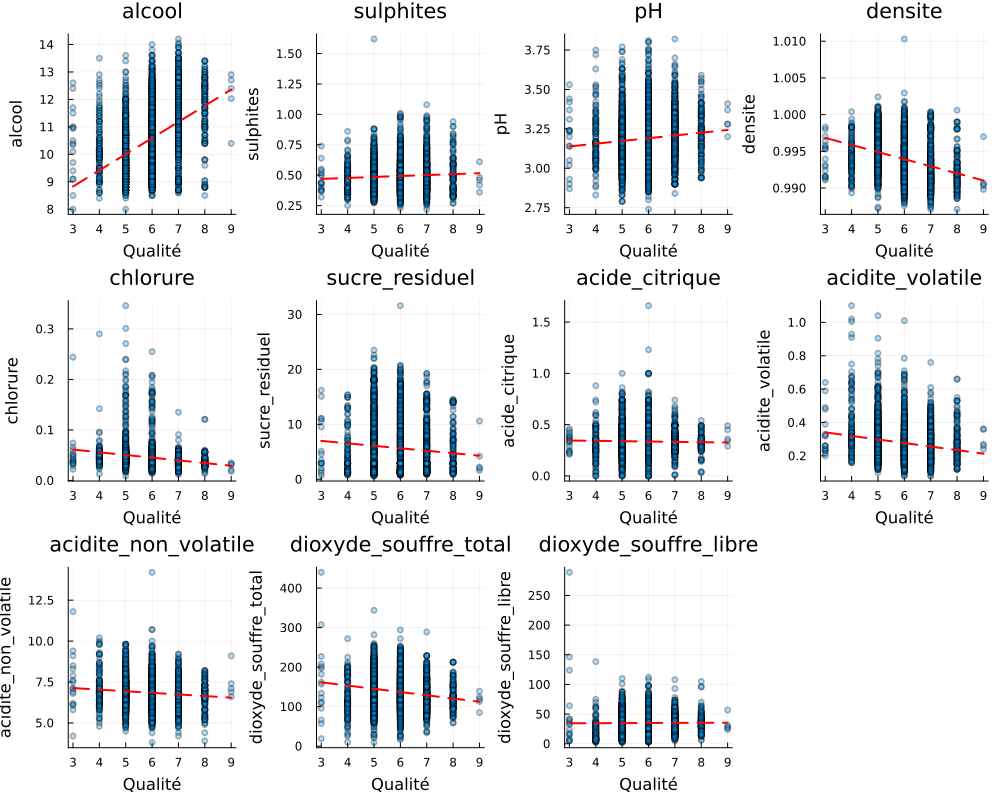

In [101]:
# 1. Sélectionner les variables explicatives
variables = [
    :alcool, :sulphites, :pH, :densite, :chlorure, :sucre_residuel,
    :acide_citrique, :acidite_volatile, :acidite_non_volatile,
    :dioxyde_souffre_total, :dioxyde_souffre_libre
]

# 2. Préparer les données (filtrer les lignes sans missing)
df = dropmissing(DataFrames.select(white_wines, [:qualite; variables]))

# 3. Définir le layout
n = length(variables)
ncols = 4
nrows = ceil(Int, n / ncols)
plot_layout = (nrows, ncols)

# 4. Créer les sous-graphiques
plots = []

for var in variables
    # Ajuster le modèle linéaire
    @eval model = lm(@formula($(var) ~ qualite), df)
    
    # Générer les prédictions
    min_q, max_q = extrema(df.qualite)
    x_range = collect(min_q:max_q)
    df_pred = DataFrame(qualite = x_range)
    df_pred[!, string(var)] = GLM.predict(model, df_pred)

    # Créer le graphique
    p = scatter(
        df.qualite, df[!, var],
        alpha=0.3, label="", title=string(var),
        xlabel="Qualité", ylabel=string(var), markersize=3
    )
    plot!(p, df_pred.qualite, df_pred[!, string(var)],
        lw=2, color=:red, line=:dash, label=""
    )

    push!(plots, p)
end

# 5. Affichage final
Plots.plot(plots..., layout=plot_layout, size=(1000, 800))

Ces nuages de points avec régressions linéaires illustrent les relations entre la qualité du vin blanc (axe des abscisses) et chacune des variables chimiques mesurées (axe des ordonnées). Voici les principales observations :

- Alcool : Il s’agit de la variable présentant la plus forte corrélation positive avec la qualité. Plus un vin est alcoolisé, plus il tend à être jugé de bonne qualité.
- Acidité volatile, densité, dioxyde de soufre total : Ces variables présentent une corrélation négative légère à modérée avec la qualité. Une forte acidité volatile ou une densité élevée semblent donc associées à des vins jugés de moindre qualité.
- Sucre résiduel, chlorure, acide citrique, pH, sulphites : Ces variables montrent très peu de variation avec la qualité. Leur influence sur l’évaluation des vins semble donc limitée ou non linéaire.
- Dioxyde de soufre libre et acidité non volatile : montrent également peu de lien linéaire direct avec la qualité.

En résumé, seules quelques variables (alcool, densité, acidité volatile) semblent avoir un lien linéaire perceptible avec la qualité. Cela confirme qu’un modèle linéaire pourrait être insuffisant et qu’un modèle plus complexe (comme XGBoost) serait plus apte à capturer les relations non linéaires entre les caractéristiques chimiques et la qualité du vin.

#### 2.2.2 Vins rouges

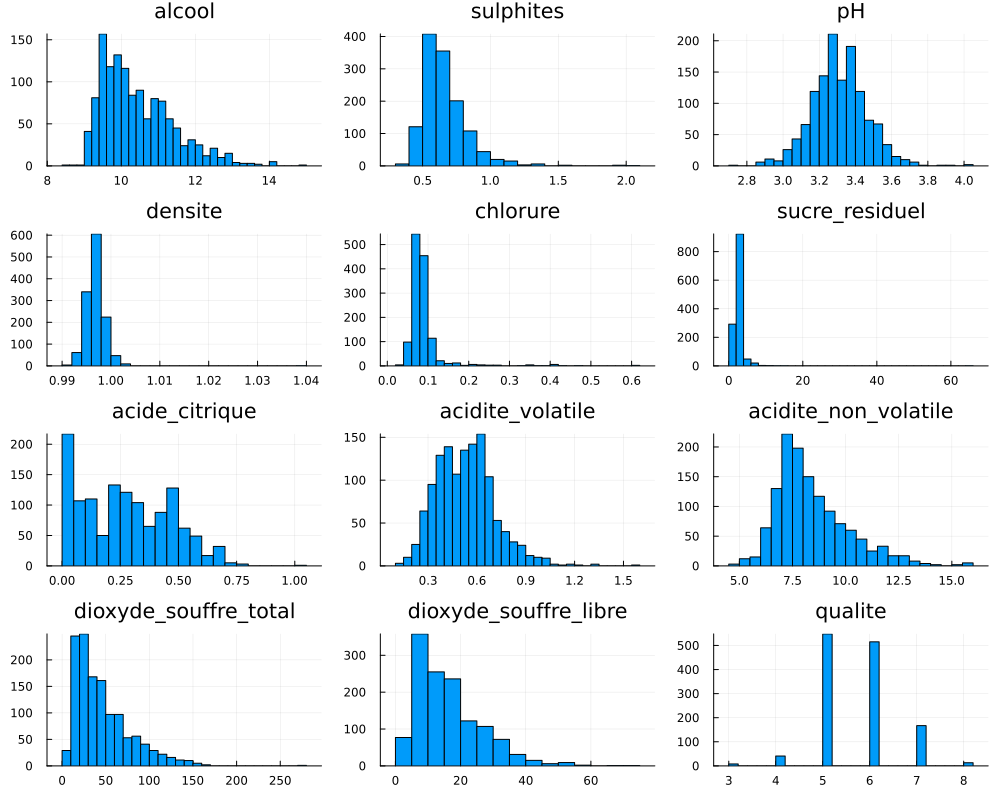

In [102]:
X = DataFrames.select(red_wines, Not(:sucre_missing))
numerical_cols = names(X)[[eltype(X[!, col]) <: Number for col in names(X)]]

plots = [Plots.histogram(X[!, col], title=col, bins=30, legend=false) for col in numerical_cols]

n = length(plots)
nrows = ceil(Int, sqrt(n))
ncols = ceil(Int, n / nrows)

Plots.plot(plots...; layout=(nrows, ncols), size=(1000, 800))

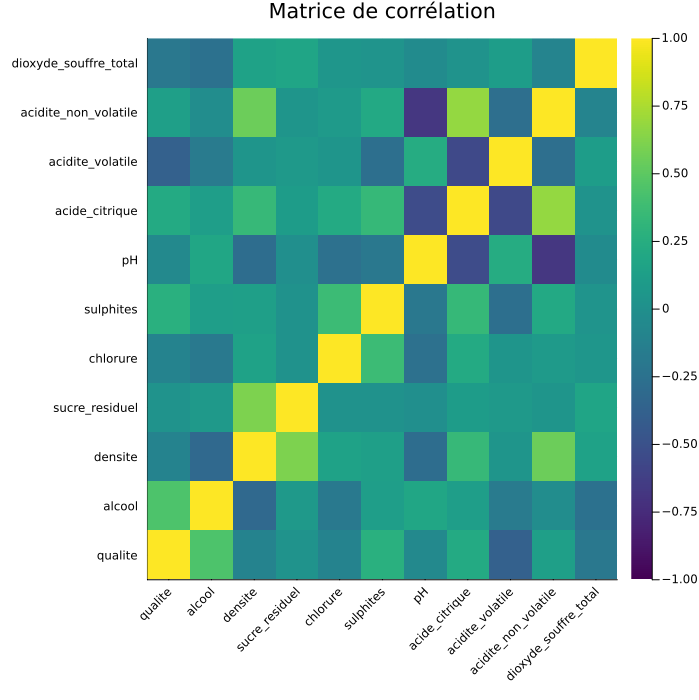

In [103]:
# Liste complète des variables numériques que tu veux inclure
numeric_vars = [:qualite, :alcool, :densite, :sucre_residuel, :chlorure, 
                :sulphites, :pH, :acide_citrique, :acidite_volatile, 
                :acidite_non_volatile, :dioxyde_souffre_total]

# Extraire les colonnes du DataFrame
df_corr = DataFrames.select(red_wines, numeric_vars)

# Calcul de la matrice de corrélation
corr_matrix = cor(Matrix(df_corr))

# Affichage de la heatmap
heatmap(corr_matrix,
    xticks=(1:length(numeric_vars), string.(numeric_vars)),
    yticks=(1:length(numeric_vars), string.(numeric_vars)),
    c=:viridis,
    title="Matrice de corrélation",
    size=(700,700),
    xrotation=45,
    clim=(-1, 1)
)

Lorsqu’on isole les vins rouges, la matrice de corrélation révèle plusieurs relations intéressantes entre les variables.

En plus de la corrélation attendue entre `sucre_residuel` et `densite`, on observe une corrélation modérée entre `chlorure` et `sulphites`, ainsi qu’un lien entre `acidite_non_volatile` et `acide_citrique`.  
Ces relations suggèrent que certains paramètres liés à l’acidité et à la conservation du vin évoluent ensemble dans les rouges.

On remarque aussi une corrélation négative entre `pH` et `acidite_volatile`, ce qui reflète la relation inverse attendue entre acidité perçue et acidité mesurée en pH.  
Enfin, les variables `alcool` et `qualite` conservent un lien positif, mais moins marqué que dans les vins blancs.

Ces observations montrent que plusieurs propriétés chimiques du vin rouge sont interconnectées, mais que leur influence sur la qualité est plus diffuse.

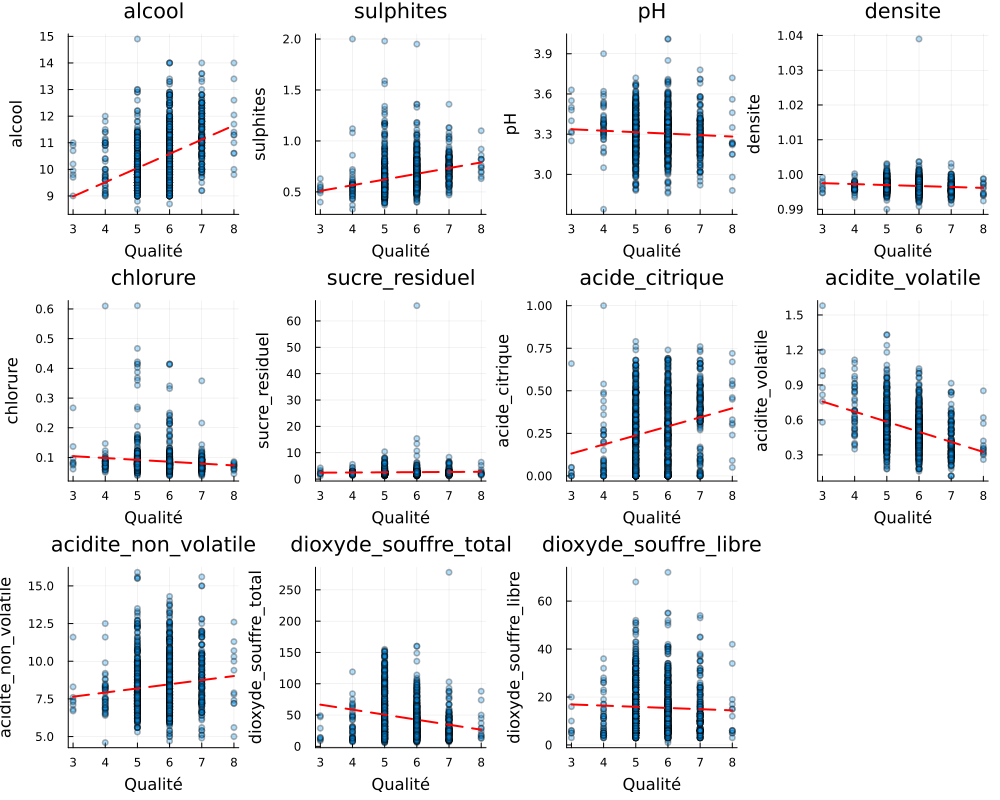

In [104]:
# 1. Sélectionner les variables explicatives
variables = [
    :alcool, :sulphites, :pH, :densite, :chlorure, :sucre_residuel,
    :acide_citrique, :acidite_volatile, :acidite_non_volatile,
    :dioxyde_souffre_total, :dioxyde_souffre_libre
]

# 2. Préparer les données (filtrer les lignes sans missing)
df = dropmissing(DataFrames.select(red_wines, [:qualite; variables]))

# 3. Définir le layout
n = length(variables)
ncols = 4
nrows = ceil(Int, n / ncols)
plot_layout = (nrows, ncols)

# 4. Créer les sous-graphiques
plots = []

for var in variables
    # Ajuster le modèle linéaire
    @eval model = lm(@formula($(var) ~ qualite), df)
    
    # Générer les prédictions
    min_q, max_q = extrema(df.qualite)
    x_range = collect(min_q:max_q)
    df_pred = DataFrame(qualite = x_range)
    df_pred[!, string(var)] = GLM.predict(model, df_pred)

    # Créer le graphique
    p = scatter(
        df.qualite, df[!, var],
        alpha=0.3, label="", title=string(var),
        xlabel="Qualité", ylabel=string(var), markersize=3
    )
    plot!(p, df_pred.qualite, df_pred[!, string(var)],
        lw=2, color=:red, line=:dash, label=""
    )

    push!(plots, p)
end

# 5. Affichage final
Plots.plot(plots..., layout=plot_layout, size=(1000, 800))

Pour le vin rouge uniquement maintenant, ces graphiques présentent la relation entre la variable qualité et les différentes caractéristiques chimiques du vin. Voici les principales observations :

Encore une fois, l'alcool est la variable qui montre la plus forte corrélation positive avec la qualité. Les vins rouges plus alcoolisés semblent en général mieux notés. L'acide citrique et l'acidité non volatile présentent aussi une légère tendance croissante, bien que plus modérée.

L'acidité volatile montre une corrélation négative avec la qualité. Les vins plus acides volatiles sont souvent moins bien évalués, ce qui est cohérent avec leur perecption de goût moins agréable.

D'autres variables comme la densité, le dioxyde de soufre total et le chlorure présentent une légère corrélation négative, suggérant que leur excès pourrait diminuer la qualité perçue.

Enfin, le sucre résiduel, le pH, les sulphites et le dioxyde de soufre libre semblent ne pas avoir de lien linéaire clair avec la qualité.

### 2.1.3 Résumé de l'analyse de la distribution des données

L’analyse des distributions et des corrélations selon le type de vin nous a permis d'identifier certaines tendances, notamment une corrélation positive entre l’alcool et la qualité, ainsi que certains effets négatifs liés à l’acidité volatile ou la densité. Toutefois, plusieurs relations apparaissent complexes ou même peu linéaires. Il est donc plus difficile de directement interpréter leur relation par rapport à la qualité du vin.

Dans l'ensemble, bien que certaines tendances linéaires soient observables, la majorité des relations semblent faibles ou non linéaires, ce qui pourrait justifier l'utilisation de modèles plus complexes comme XGBoost pour mieux capter ces interactions.


## 2.2 Analyse de la corrélation

Nous avons ensuite analysé les corrélations entre toutes les fonctionnalités et la qualité du vin pour identifier les caractéristiques les plus influentes. Pour cela, nous avons créé deux versions des données d'entraînement : la première avec toutes les valeurs manquantes remplacées par la moyenne/médiane (une approximation suffisante pour cette analyse) et la seconde en conservant les types de vin originaux ("blanc", "rouge", "manquant") tout en imputant les autres valeurs manquantes afin d'étudier les corrélations spécifiques à chaque type de vin.


### 2.2.1 Traitement des valeurs manquantes

In [105]:
train_corr = CSV.read("train.csv", DataFrame, missingstring="NA")

function mode(x)
    uvals = unique(x)
    return uvals[argmax([sum(x .== uval) for uval in uvals])]
end

train_type_original = copy(train_corr)

if sum(ismissing.(train_corr.type)) > 0
    most_common_type = mode(skipmissing(train_corr.type))
    train_corr.type = replace(train_corr.type, missing => most_common_type)
    println("Valeurs manquantes dans 'type' remplacées par: $most_common_type")
end

for col in ["alcool", "densite", "sucre_residuel"]
    if sum(ismissing.(train_type_original[:, col])) > 0
        col_mean = mean(skipmissing(train_type_original[:, col]))
        train_type_original[:, col] = replace(train_type_original[:, col], missing => col_mean)
        println("Valeurs manquantes de train_type_original dans '$col' remplacées par la moyenne: $col_mean")
    end
end

for col in ["alcool", "densite", "sucre_residuel"]
    if sum(ismissing.(train_corr[:, col])) > 0
        col_mean = mean(skipmissing(train_corr[:, col]))
        train_corr[:, col] = replace(train_corr[:, col], missing => col_mean)
        println("Valeurs manquantes dans '$col' remplacées par la moyenne: $col_mean")
    end
end

Valeurs manquantes dans 'type' remplacées par: blanc
Valeurs manquantes de train_type_original dans 'alcool' remplacées par la moyenne: 10.487563399316345
Valeurs manquantes de train_type_original dans 'densite' remplacées par la moyenne: 0.99469356115984
Valeurs manquantes de train_type_original dans 'sucre_residuel' remplacées par la moyenne: 5.412428160919537
Valeurs manquantes dans 'alcool' remplacées par la moyenne: 10.487563399316345
Valeurs manquantes dans 'densite' remplacées par la moyenne: 0.99469356115984
Valeurs manquantes dans 'sucre_residuel' remplacées par la moyenne: 5.412428160919537


Ici on vérifie si il reste des données manquantes

In [106]:
any_missing = false
for col in names(train_corr)
    if any(ismissing.(train_corr[:, col]))
        println("Il reste des valeurs manquantes dans '$col'")
        any_missing = true
    end
end

if !any_missing
    println("Toutes les valeurs manquantes ont été traitées!")
end

Toutes les valeurs manquantes ont été traitées!


Maintenant que les valeurs manquantes ont été traitées, on peut analyser les corrélations

### 2.2.2 Corrélation globale

In [107]:
train_numeric = copy(train_corr)
train_numeric.type_numeric = [x == "rouge" ? 1.0 : 0.0 for x in train_numeric.type]
println(unique(train_numeric.type_numeric))

numeric_cols = [col for col in names(train_numeric) if col != "type"]
correlation_matrix = cor(Matrix(train_numeric[:, numeric_cols]))

println("Matrice de corrélation:")
display(DataFrame(correlation_matrix, numeric_cols))

quality_index = findfirst(x -> x == "qualite", numeric_cols)
quality_correlations = correlation_matrix[:, quality_index]
feature_correlations = [(numeric_cols[i], quality_correlations[i]) for i in 1:length(numeric_cols)]
Base.sort!(feature_correlations, by = x -> abs(x[2]), rev = true)

[0.0, 1.0]
Matrice de corrélation:


Row,alcool,sulphites,pH,densite,chlorure,sucre_residuel,acide_citrique,acidite_volatile,acidite_non_volatile,dioxyde_souffre_total,dioxyde_souffre_libre,qualite,type_numeric
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,1.0,-0.00487708,0.109792,-0.50191,-0.228786,-0.267081,-0.0212268,-0.0285651,-0.0813203,-0.237114,-0.165702,0.395015,-0.0242449
2,-0.00487708,1.0,0.186053,0.231586,0.387458,-0.162418,0.0598823,0.217688,0.307354,-0.283022,-0.189022,0.0463762,0.218912
3,0.109792,0.186053,1.0,0.00473856,0.0403118,-0.235816,-0.339518,0.2678,-0.246763,-0.244475,-0.14329,0.0224256,0.142077
4,-0.50191,0.231586,0.00473856,1.0,0.322058,0.423014,0.0847005,0.24385,0.410716,0.0181863,0.01545,-0.269522,0.172277
5,-0.228786,0.387458,0.0403118,0.322058,1.0,-0.114003,0.0492491,0.369343,0.302525,-0.286528,-0.204264,-0.197366,0.230982
6,-0.267081,-0.162418,-0.235816,0.423014,-0.114003,1.0,0.135077,-0.176491,-0.105014,0.454955,0.364426,-0.0294972,-0.135754
7,-0.0212268,0.0598823,-0.339518,0.0847005,0.0492491,0.135077,1.0,-0.386101,0.319316,0.196351,0.132861,0.0746197,-0.0660143
8,-0.0285651,0.217688,0.2678,0.24385,0.369343,-0.176491,-0.386101,1.0,0.211761,-0.413837,-0.352347,-0.260124,0.300588
9,-0.0813203,0.307354,-0.246763,0.410716,0.302525,-0.105014,0.319316,0.211761,1.0,-0.335512,-0.287399,-0.0727021,0.228654


13-element Vector{Tuple{String, Float64}}:
 ("qualite", 1.0)
 ("alcool", 0.39501453840492534)
 ("densite", -0.2695217761458005)
 ("acidite_volatile", -0.26012397394425263)
 ("chlorure", -0.19736613891444332)
 ("acide_citrique", 0.07461968449049733)
 ("acidite_non_volatile", -0.07270206053694728)
 ("dioxyde_souffre_libre", 0.058677343173647034)
 ("type_numeric", -0.04965545470233096)
 ("sulphites", 0.046376205824133994)
 ("dioxyde_souffre_total", -0.03936694681914937)
 ("sucre_residuel", -0.029497210848331137)
 ("pH", 0.022425571171245957)

### 2.2.3 Corrélation par type de vin

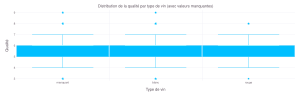

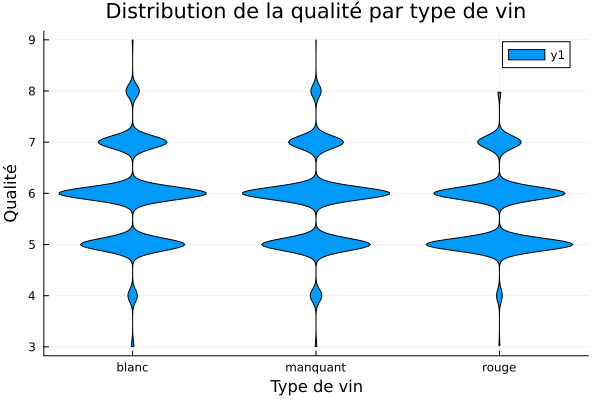

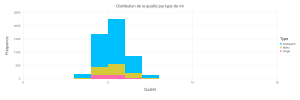

Statistiques de qualité par type de vin:


Row,type_category,count,mean_quality,median_quality,std_quality,min_quality,max_quality
,Abstract…,Int64,Float64,Float64,Float64,Int64,Int64
1,manquant,3897,5.82191,6.0,0.872582,3,9
2,blanc,959,5.90511,6.0,0.914032,3,9
3,rouge,341,5.66276,6.0,0.771204,3,8


In [108]:
train_for_viz = copy(train_type_original)
train_for_viz.type_category = [ismissing(t) ? "manquant" : t for t in train_for_viz.type]

p1 = Gadfly.plot(train_for_viz, x=:type_category, y=:qualite, Geom.boxplot,
    Guide.xlabel("Type de vin"), Guide.ylabel("Qualité"),
    Guide.title("Distribution de la qualité par type de vin (avec valeurs manquantes)"))
display(p1)


p2 = @df train_for_viz violin(:type_category, :qualite, 
    xlabel="Type de vin", ylabel="Qualité", 
    title="Distribution de la qualité par type de vin")
display(p2)

p3 = Gadfly.plot(train_for_viz, x=:qualite, color=:type_category, Geom.histogram(bincount=10),
    Guide.xlabel("Qualité"), Guide.ylabel("Fréquence"),
    Guide.title("Distribution de la qualité par type de vin"),
    Guide.colorkey(title="Type"))
display(p3)

quality_by_type = combine(groupby(train_for_viz, :type_category)) do df
    DataFrame(
        count = size(df, 1),
        mean_quality = mean(df.qualite),
        median_quality = median(df.qualite),
        std_quality = std(df.qualite),
        min_quality = minimum(df.qualite),
        max_quality = maximum(df.qualite)
    )
end
println("Statistiques de qualité par type de vin:")
display(quality_by_type)

Les données révèlent des variations notables dans la qualité moyenne selon le type de vin. Les vins blancs obtiennent le score moyen le plus élevé 
(5.91) suivis des vins sans type spécifié ("manquant" 5.82) et des vins rouges (5.66). Bien que la médiane soit identique 
(6.0 pour les trois catégories) l'écart-type plus élevé des vins blancs (0.91 contre 0.77 pour les rouges) 
suggère une plus grande variabilité dans leur qualité. La distribution plus resserrée des rouges avec un maximum de 8 contre 9 pour les autres types.
Cet observation confirment l'intérêt d'analyser séparément les corrélations pour chaque type de vin.


11×4 DataFrame
 Row │ feature                rouge_corr   blanc_corr   missing_corr 
     │ String                 Float64      Float64      Float64      
─────┼───────────────────────────────────────────────────────────────
   1 │ alcool                  0.369216     0.424895      0.38763
   2 │ acidite_volatile       -0.286059    -0.168778     -0.271901
   3 │ sulphites               0.282516     0.110031      0.0356207
   4 │ dioxyde_souffre_total  -0.181963    -0.178406     -0.0389282
   5 │ acide_citrique          0.158462    -0.0338788     0.085935
   6 │ sucre_residuel          0.0867907   -0.119388     -0.0207103
   7 │ densite                -0.0668708   -0.29068      -0.267312
   8 │ acidite_non_volatile    0.0646053   -0.0990939    -0.0660449
   9 │ dioxyde_souffre_libre  -0.0419423    0.00168126    0.0598459
  10 │ pH                     -0.00407795   0.157391      0.00435045
  11 │ chlorure               -0.00217858  -0.207107     -0.203579


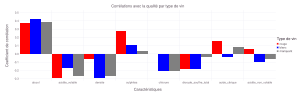

In [109]:
function calculate_correlations_by_type(df, type_value)
    type_data = filter(row -> row.type_category == type_value, df)
    
    numeric_cols = [col for col in names(type_data) 
                    if col != "type" && col != "type_category" && 
                       eltype(type_data[!, col]) <: Union{Number, Missing}]
    
    correlation_matrix = cor(Matrix(type_data[:, numeric_cols]))
    
    quality_index = findfirst(x -> x == "qualite", numeric_cols)
    
    quality_correlations = correlation_matrix[:, quality_index]
    
    feature_correlations = [(numeric_cols[i], quality_correlations[i]) 
                           for i in 1:length(numeric_cols)]
    Base.sort!(feature_correlations, by = x -> abs(x[2]), rev = true)
    
    return feature_correlations
end

rouge_correlations = calculate_correlations_by_type(train_for_viz, "rouge")
blanc_correlations = calculate_correlations_by_type(train_for_viz, "blanc")
missing_correlations = calculate_correlations_by_type(train_for_viz, "manquant")

correlation_df = DataFrame(
    feature = String[],
    rouge_corr = Float64[],
    blanc_corr = Float64[],
    missing_corr = Float64[]
)

all_features = unique(vcat(
    [f for (f, _) in rouge_correlations if f != "qualite"],
    [f for (f, _) in blanc_correlations if f != "qualite"],
    [f for (f, _) in missing_correlations if f != "qualite"]
))

for feature in all_features
    rouge_idx = findfirst(x -> x[1] == feature, rouge_correlations)
    blanc_idx = findfirst(x -> x[1] == feature, blanc_correlations)
    missing_idx = findfirst(x -> x[1] == feature, missing_correlations)
    
    rouge_val = rouge_idx !== nothing ? rouge_correlations[rouge_idx][2] : 0.0
    blanc_val = blanc_idx !== nothing ? blanc_correlations[blanc_idx][2] : 0.0
    missing_val = missing_idx !== nothing ? missing_correlations[missing_idx][2] : 0.0

    push!(correlation_df, (
        feature = feature,
        rouge_corr = rouge_val,
        blanc_corr = blanc_val,
        missing_corr = missing_val
    ))

end
println(correlation_df)
sorted = sort(eachrow(correlation_df), by = row -> abs(row.rouge_corr) + abs(row.blanc_corr) + abs(row.missing_corr), rev = true)
correlation_df .= DataFrame(sorted)

corr_long = DataFrame(
    feature = repeat(correlation_df.feature, 3),
    type = vcat(
        fill("rouge", nrow(correlation_df)),
        fill("blanc", nrow(correlation_df)),
        fill("manquant", nrow(correlation_df))
    ),
    correlation = vcat(
        correlation_df.rouge_corr,
        correlation_df.blanc_corr,
        correlation_df.missing_corr
    )
)

top_features = correlation_df.feature[1:min(8, nrow(correlation_df))]
corr_long_filtered = filter(row -> row.feature in top_features, corr_long)

p4 = Gadfly.plot(corr_long_filtered, x=:feature, y=:correlation, color=:type, Geom.bar(position=:dodge),
    Guide.title("Corrélations avec la qualité par type de vin"),
    Guide.xlabel("Caractéristiques"),
    Guide.ylabel("Coefficient de corrélation"),
    Scale.color_discrete_manual("red", "blue", "gray"),
    Guide.colorkey(title="Type de vin"))
display(p4)

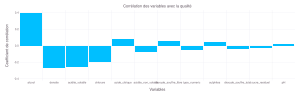

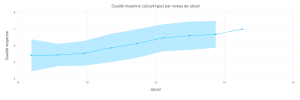

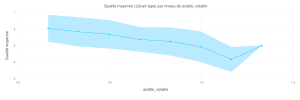

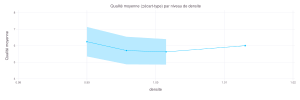

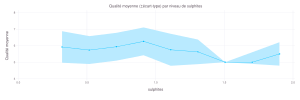

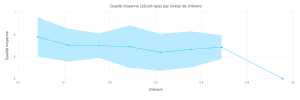

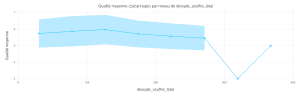

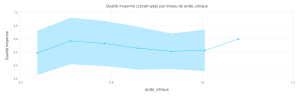

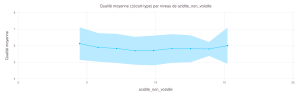

In [110]:
features = [feat for (feat, _) in feature_correlations if feat != "qualite"]
correlations = [corr for (feat, corr) in feature_correlations if feat != "qualite"]

p3 = Gadfly.plot(x=features, y=correlations, Geom.bar,
    Guide.xlabel("Variables"), Guide.ylabel("Coefficient de corrélation"),
    Guide.title("Corrélation des variables avec la qualité"),
    Theme(bar_spacing=1mm))
display(p3)

for feature in top_features
    breaks = range(minimum(train_corr[:, Symbol(feature)]), maximum(train_corr[:, Symbol(feature)]), length=10)
    
    summary_df = DataFrame(bin_center=Float64[], mean_quality=Float64[], 
                         lower=Float64[], upper=Float64[])
    
    for i in 1:(length(breaks)-1)
        bin_data = filter(row -> row[Symbol(feature)] >= breaks[i] && 
                             row[Symbol(feature)] < breaks[i+1], train_corr)
        if nrow(bin_data) > 0
            bin_center = (breaks[i] + breaks[i+1]) / 2
            mean_qual = mean(bin_data.qualite)
            std_qual = std(bin_data.qualite)
            push!(summary_df, (bin_center, mean_qual, mean_qual-std_qual, mean_qual+std_qual))
        end
    end
    
    p = Gadfly.plot(layer(summary_df, x=:bin_center, y=:mean_quality, Geom.line, Geom.point),
             layer(summary_df, x=:bin_center, ymin=:lower, ymax=:upper, Geom.ribbon),
             Guide.xlabel(feature), Guide.ylabel("Qualité moyenne"),
             Guide.title("Qualité moyenne (±écart-type) par niveau de $feature"))
    display(p)
end

### 2.2.4 Résumé de l'exploration de la corrélation
L'alcool apparaît comme le facteur principal influençant positivement la qualité (+0.39) tandis que la densité, l'acidité volatile et la teneur en chlorures impactent négativement les scores (-0.27, -0.26 et -0.20 respectivement). Plus précisément :

- **Relation positive** : Un taux d'alcool plus élevé améliore systématiquement la qualité

- **Relations négatives** : La densité, l'acidité et la concentration en chlorures sont associées à une baisse de qualité

- **Facteurs neutres** : Le pH et le sucre résiduel montrent peu d'influence (|corrélations| < 0.07)

#### Nuance importante 
Ces tendances générales masquent des variations significatives selon le type de vin. Par exemple, les sulphites présentent une corrélation positive notable (+0.28) pour les vins rouges contrairement à leur effet global neutre. Cette observation confirme la nécessité d'analyses spécifiques par catégorie de vin.

En conclusion, si l'alcool, la densité et l'acidité constituent des déterminants universels de qualité leur importance relative varie considérablement selon les types de vins ce qui implique des approches différenciées pour l'évaluation qualitative.


# 3. Exploration des modèles

On peut maintenant passer à l'exploration des modèles afin d'identifier celui qui offrira les prédictions les plus précises.

## 3.1 Modèles de régression linéaire


### 3.1.1 Vin Rouge

##### Standardisation des données
La standardisation des données est une étape cruciale dans le pré-traitement des données avant d'appliquer un modèle de régression linéaire et ce, surtout pour les modèles de type `Ridge` et `Lasso`.

In [111]:
standardizer = Standardizer()
stand_machine = machine(standardizer, X_red)
fit!(stand_machine, verbosity=0)
X_red_std = MLJ.transform(stand_machine, X_red)
describe(X_red_std)

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,alcool,2.95214e-16,-1.94709,-0.204324,4.63523,0,Float64
2,sulphites,-7.87812e-16,-1.94764,-0.223501,7.98101,0,Float64
3,pH,-2.76353e-15,-3.75025,0.0136462,4.63598,0,Float64
4,densite,-7.46565e-14,-3.26528,-0.0449542,20.3071,0,Float64
5,chlorure,1.40239e-16,-1.07144,-0.181332,11.2185,0,Float64
6,sucre_residuel,-3.96656e-16,-0.685685,-0.101443,30.766,0,Float64
7,acide_citrique,-2.08468e-16,-1.40311,-0.0617339,3.75603,0,Float64
8,acidite_volatile,-1.70486e-16,-2.27532,-0.0503923,5.84566,0,Float64
9,acidite_non_volatile,-1.39345e-15,-2.19252,-0.215814,4.37713,0,Float64


#### 3.1.1.1 Régression Ridge

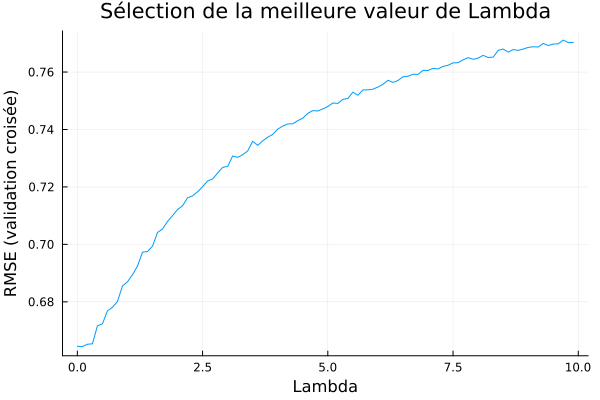

In [112]:
lambdas = collect(0.001:0.1:10.0)  # Plage de valeurs de lambda à explorer
rmse_values = Float64[]

# Définition de la validation croisée à 5 plis
cv = CV(nfolds=5, shuffle=true, rng=1234)

for lambda in lambdas
    # Définition du modèle Ridge avec la valeur actuelle de lambda
    model = RidgeRegressor(lambda = lambda)
    
    # Création de la machine en utilisant les données standardisées X_std
    mach = machine(model, X_red_std, y_red)
    
    # Évaluation du modèle avec validation croisée et calcul du RMSE
    evaluation = evaluate!(mach, resampling=cv, measure=rms, verbosity=0)
    
    # Stockage du RMSE moyen obtenu sur les plis
    push!(rmse_values, evaluation.measurement[1])
end

# Affichage du graphique RMSE en fonction de lambda
Plots.plot(lambdas, rmse_values,
     xlabel = "Lambda",
     ylabel = "RMSE (validation croisée)",
     title = "Sélection de la meilleure valeur de Lambda",
     legend = false)

In [113]:
# 1. Définir le modèle Ridge de base
ridge = RidgeRegressor()

# 2. Définir la plage de lambda à explorer
range_lambda = range(ridge, :lambda, lower=0.001, upper=10.0, scale=:log)

# 3. Créer le modèle tuné
tuned_ridge = TunedModel(
    model = ridge,
    tuning = Grid(resolution=30),
    resampling = CV(nfolds=5, shuffle=true, rng=1234),
    range = range_lambda,
    measure = rms
)

# 4. Créer la machine
mach_ridge = machine(tuned_ridge, X_red_std, y_red)

# 5. Entraîner le modèle
fit!(mach_ridge, verbosity=0)


# Évalutation du modèle Ridge
eval_ridge = evaluate!(mach_ridge, resampling=CV(nfolds=5, shuffle=true, rng=1234), measure=rms)

PerformanceEvaluation object with these fields:
  model, measure, operation,
  measurement, per_fold, per_observation,
  fitted_params_per_fold, report_per_fold,
  train_test_rows, resampling, repeats
Extract:
┌────────────────────────┬───────────┬─────────────┐
│ measure                │ operation │ measurement │
├────────────────────────┼───────────┼─────────────┤
│ RootMeanSquaredError() │ predict   │ 0.664       │
└────────────────────────┴───────────┴─────────────┘
┌─────────────────────────────────────┬─────────┐
│ per_fold                            │ 1.96*SE │
├─────────────────────────────────────┼─────────┤
│ [0.659, 0.667, 0.666, 0.711, 0.616] │ 0.0328  │
└─────────────────────────────────────┴─────────┘


On constate que la régression Ridge n’apporte pas de réel avantage ici, puisque la valeur optimale du coefficient de régularisation `lambda` est proche de zéro.  
Cela indique que la multicolinéarité entre les variables explicatives n’a pas d’impact négatif significatif sur les performances du modèle.

Nous allons donc poursuivre avec une régression lasso pour confirmer.

#### 3.1.1.2 Régression Lasso

Coefficients Lasso (lambda = 0.004520353656360246)
alcool              0.268
sulphites           0.1528
pH                  -0.0584
densite             -0.0047
chlorure            -0.0828
sucre_residuel      0.0322
acide_citrique      -0.024
acidite_volatile    -0.2044
acidite_non_volatile0.0
dioxyde_souffre_total-0.1092
dioxyde_souffre_libre0.0503


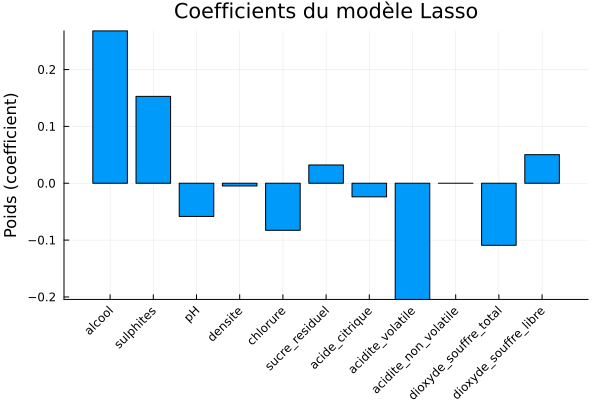

In [114]:
# 2. Définir le modèle de base
lasso = LassoRegressor()

# 3. Définir la plage de lambda à tester
range_lambda = range(lasso, :lambda, lower=1e-4, upper=1.0, scale=:log)

# 4. Créer le modèle tuné
tuned_lasso = TunedModel(
    model = lasso,
    tuning = Grid(resolution=30),
    resampling = CV(nfolds=5, shuffle=true, rng=1234),
    range = range_lambda,
    measure = rms
)

# 5. Entraîner la machine
mach_lasso = machine(tuned_lasso, X_red_std, y_red)
fit!(mach_lasso, verbosity=0)

params = fitted_params(mach_lasso)
coefs = params.best_fitted_params.coefs
lambda = params.best_model.lambda

# 7. Afficher les coefficients
println("Coefficients Lasso (lambda = ", lambda, ")")
for (name, coef) in zip(names(X_red_std), coefs)
    println(rpad(name, 20), round(coef.second, digits=4))
end

# Extraire noms et valeurs séparément
var_names = [string(c.first) for c in coefs]
coef_vals = [c.second for c in coefs]

# Graphique en barres
bar(var_names, coef_vals,
    xlabel = "Variables",
    ylabel = "Poids (coefficient)",
    title = "Coefficients du modèle Lasso",
    legend = false,
    xticks = :all,
    xrotation = 45)

In [115]:
eval_lasso = evaluate!(mach_lasso, resampling=CV(nfolds=5, shuffle=true, rng=1234), measure=rms)

Evaluating over 5 folds: 100%[=========================] Time: 0:00:00


PerformanceEvaluation object with these fields:
  model, measure, operation,
  measurement, per_fold, per_observation,
  fitted_params_per_fold, report_per_fold,
  train_test_rows, resampling, repeats
Extract:
┌────────────────────────┬───────────┬─────────────┐
│ measure                │ operation │ measurement │
├────────────────────────┼───────────┼─────────────┤
│ RootMeanSquaredError() │ predict   │ 0.665       │
└────────────────────────┴───────────┴─────────────┘
┌────────────────────────────────────┬─────────┐
│ per_fold                           │ 1.96*SE │
├────────────────────────────────────┼─────────┤
│ [0.662, 0.67, 0.664, 0.707, 0.617] │ 0.0313  │
└────────────────────────────────────┴─────────┘


Dans ce cas-ci, la régression Lasso n’apporte pas de gain de performance par rapport à Ridge, mais permet d’éliminer ou réduire fortement certains coefficients peu informatifs.  
Elle agit donc comme un outil de simplification et de sélection de variables, même si `lambda` est très faible.

Passons donc à une régression linéaire simple.

#### 3.1.1.3 Régression Linéaire Simple

In [116]:
# Créer le modèle
lin_model = LinearRegressor()

# Créer et entraîner la machine
mach_red_lin = machine(lin_model, X_red, y_red)
fit!(mach_red_lin, verbosity=0)

trained Machine; caches model-specific representations of data
  model: LinearRegressor(fit_intercept = true, …)
  args: 
    1:	Source @253 ⏎ Table{AbstractVector{Continuous}}
    2:	Source @560 ⏎ AbstractVector{Continuous}


In [117]:
cv = CV(nfolds=5, shuffle=true, rng=1234)
eval_lin = evaluate!(mach_red_lin, resampling=cv, measure=rms)

PerformanceEvaluation object with these fields:
  model, measure, operation,
  measurement, per_fold, per_observation,
  fitted_params_per_fold, report_per_fold,
  train_test_rows, resampling, repeats
Extract:
┌────────────────────────┬───────────┬─────────────┐
│ measure                │ operation │ measurement │
├────────────────────────┼───────────┼─────────────┤
│ RootMeanSquaredError() │ predict   │ 0.665       │
└────────────────────────┴───────────┴─────────────┘
┌─────────────────────────────────────┬─────────┐
│ per_fold                            │ 1.96*SE │
├─────────────────────────────────────┼─────────┤
│ [0.663, 0.672, 0.664, 0.705, 0.616] │ 0.0315  │
└─────────────────────────────────────┴─────────┘


La régression linéaire simple atteint un RMSE de 0.665, soit une performance identique à celle obtenue avec la régression Ridge ou Lasso lorsque `lambda = 0`.  
Cela confirme que la régularisation n’apporte ici aucun gain significatif, et que le modèle linéaire standard suffit pour capturer la relation entre les variables.

#### 3.1.1.4 Comparaison des modèles linéaires pour le vin rouge

┌──────────┬─────────┐
│   Modèle │    RMSE │
│   String │ Float64 │
├──────────┼─────────┤
│ Linéaire │  0.6646 │
│    Ridge │  0.6645 │
│    Lasso │  0.6646 │
└──────────┴─────────┘


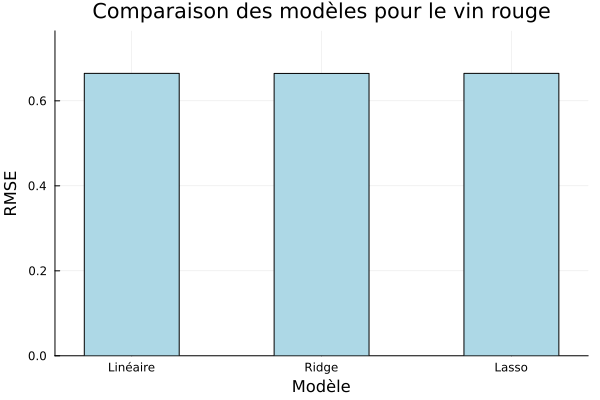

In [118]:
using PrettyTables, DataFrames, Plots

# Données du tableau
model_names = ["Linéaire", "Ridge", "Lasso"]
rmse_vals = round.([eval_lin.measurement[1], eval_ridge.measurement[1], eval_lasso.measurement[1]], digits=4)

# Créer le DataFrame pour le tableau
df_results = DataFrame(Modèle = model_names, RMSE = rmse_vals)

# Afficher le tableau
pretty_table(df_results)

# Créer un graphique à barres
bar(model_names, rmse_vals,
    xlabel = "Modèle",
    ylabel = "RMSE",
    title = "Comparaison des modèles pour le vin rouge",
    legend = false,
    bar_width = 0.5,
    color = [:lightblue :lightgreen :salmon],
    ylim = (0, maximum(rmse_vals) + 0.1))


Comme on peut le voir dans ce tableau, les trois modèles ont obtenu un RMSE moyen quasi-identique. On peut donc conclure que la régression Ridge et la régression Lasso n'apportent pas de gain significatif en termes de précision par rapport à la régression linéaire.

### 3.1.2 Vin Blanc

##### Standardisation des données

In [119]:
standardizer = Standardizer()
stand_machine = machine(standardizer, X_white)
fit!(stand_machine, verbosity=0)
X_white_std = MLJ.transform(stand_machine, X_white)
describe(X_white_std)

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,alcool,-2.01427e-15,-2.09642,-0.105919,3.04571,0,Float64
2,sulphites,-3.60275e-16,-2.31302,-0.104124,9.58102,0,Float64
3,pH,6.99625e-16,-2.95667,-0.0573883,4.15975,0,Float64
4,densite,-2.03901e-14,-2.44272,-0.106264,5.72958,0,Float64
5,chlorure,8.44281e-16,-1.64802,-0.122782,13.4698,0,Float64
6,sucre_residuel,5.80443e-16,-1.08156,-0.592194,5.51426,0,Float64
7,acide_citrique,3.44809e-16,-2.72134,-0.128679,10.7281,0,Float64
8,acidite_volatile,-3.12966e-16,-1.91271,-0.187339,7.8644,0,Float64
9,acidite_non_volatile,-3.03868e-16,-3.5843,-0.0577672,8.64103,0,Float64


#### 3.1.2.1 Régression Ridge

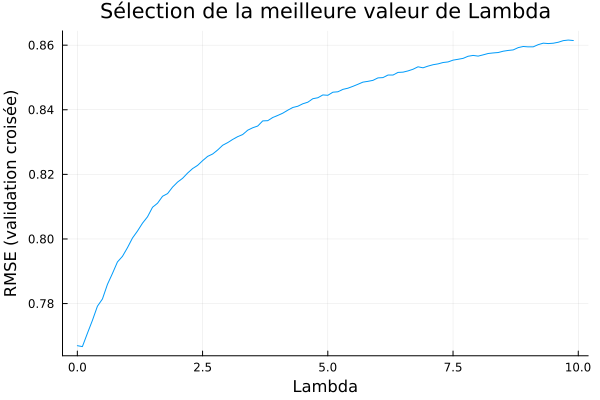

In [120]:
lambdas = collect(0.001:0.1:10.0)  # Plage de valeurs de lambda à explorer (à ajuster)
rmse_values = Float64[]           # Pour stocker les RMSE pour chaque lambda

# Définition de la validation croisée à 5 plis
cv = CV(nfolds=5, shuffle=true, rng=1234)

for lambda in lambdas
    # Définition du modèle Ridge avec la valeur actuelle de lambda
    model = RidgeRegressor(lambda = lambda)
    
    # Création de la machine en utilisant les données standardisées X_std
    mach = machine(model, X_white_std, y_white)
    
    # Évaluation du modèle avec validation croisée et calcul du RMSE
    evaluation = evaluate!(mach, resampling=cv, measure=rms, verbosity=0)
    
    # Stockage du RMSE moyen obtenu sur les plis
    push!(rmse_values, evaluation.measurement[1])
end

# 3. Affichage du graphique RMSE en fonction de lambda
Plots.plot(lambdas, rmse_values,
     xlabel = "Lambda",
     ylabel = "RMSE (validation croisée)",
     title = "Sélection de la meilleure valeur de Lambda",
     legend = false)

In [121]:
# 1. Définir le modèle Ridge de base
ridge = RidgeRegressor()

# 2. Définir la plage de lambda à explorer
range_lambda = range(ridge, :lambda, lower=0.001, upper=10.0, scale=:log)

# 3. Créer le modèle tuné
tuned_ridge = TunedModel(
    model = ridge,
    tuning = Grid(resolution=30),
    resampling = CV(nfolds=5, shuffle=true, rng=1234),
    range = range_lambda,
    measure = rms
)

# 4. Créer la machine
mach_ridge = machine(tuned_ridge, X_white_std, y_white)

# 5. Entraîner le modèle
fit!(mach_ridge, verbosity=0)


# Évalutation du modèle Ridge
eval_ridge = evaluate!(mach_ridge, resampling=CV(nfolds=5, shuffle=true, rng=1234), measure=rms)

Evaluating over 5 folds: 100%[=========================] Time: 0:00:00


PerformanceEvaluation object with these fields:
  model, measure, operation,
  measurement, per_fold, per_observation,
  fitted_params_per_fold, report_per_fold,
  train_test_rows, resampling, repeats
Extract:
┌────────────────────────┬───────────┬─────────────┐
│ measure                │ operation │ measurement │
├────────────────────────┼───────────┼─────────────┤
│ RootMeanSquaredError() │ predict   │ 0.767       │
└────────────────────────┴───────────┴─────────────┘
┌───────────────────────────────────┬─────────┐
│ per_fold                          │ 1.96*SE │
├───────────────────────────────────┼─────────┤
│ [0.767, 0.8, 0.804, 0.695, 0.763] │ 0.0428  │
└───────────────────────────────────┴─────────┘


Comme pour le vin rouge, la régression Ridge n’apporte ici aucun avantage notable : la valeur optimale de `lambda` est proche de zéro.  
Cela suggère que la multicolinéarité n’affecte pas significativement les performances du modèle.

Nous allons donc tester une régression Lasso pour valider ce constat.

#### 3.1.2.2 Régression Lasso

Coefficients Lasso (lambda = 0.006210169418915622)
alcool              0.4375
sulphites           0.0405
pH                  0.0227
densite             -0.0
chlorure            -0.0266
sucre_residuel      0.0969
acide_citrique      -0.0011
acidite_volatile    -0.1828
acidite_non_volatile-0.03
dioxyde_souffre_total-0.0
dioxyde_souffre_libre0.0731


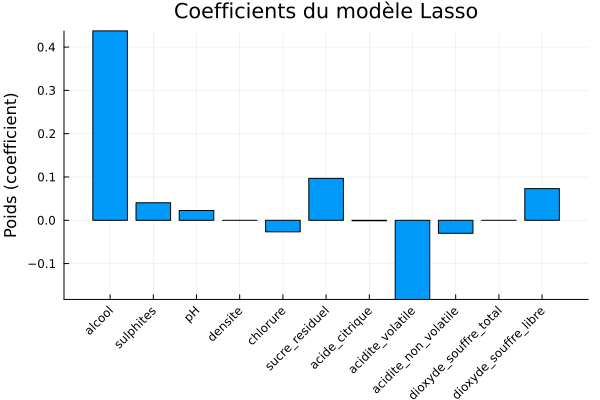

In [122]:
# 2. Définir le modèle de base
lasso = LassoRegressor()

# 3. Définir la plage de lambda à tester
range_lambda = range(lasso, :lambda, lower=1e-4, upper=1.0, scale=:log)

# 4. Créer le modèle tuné
tuned_lasso = TunedModel(
    model = lasso,
    tuning = Grid(resolution=30),
    resampling = CV(nfolds=5, shuffle=true, rng=1234),
    range = range_lambda,
    measure = rms
)

# 5. Entraîner la machine
mach_lasso = machine(tuned_lasso, X_white_std, y_white)
fit!(mach_lasso, verbosity=0)

params = fitted_params(mach_lasso)
coefs = params.best_fitted_params.coefs
lambda = params.best_model.lambda

# 7. Afficher les coefficients
println("Coefficients Lasso (lambda = ", lambda, ")")
for (name, coef) in zip(names(X_red_std), coefs)
    println(rpad(name, 20), round(coef.second, digits=4))
end

# Extraire noms et valeurs séparément
var_names = [string(c.first) for c in coefs]       # noms des variables (Symbol → String)
coef_vals = [c.second for c in coefs]              # valeurs des coefficients

# Graphique en barres
bar(var_names, coef_vals,
    xlabel = "Variables",
    ylabel = "Poids (coefficient)",
    title = "Coefficients du modèle Lasso",
    legend = false,
    xticks = :all,
    xrotation = 45)

Même chose que pour le vin rouge ici encore une fois avec quelques coefficients plus prononcés que d'autres.

In [123]:
eval_lasso = evaluate!(mach_lasso, resampling=CV(nfolds=5, shuffle=true, rng=1234), measure=rms)

Evaluating over 5 folds: 100%[=========================] Time: 0:00:01


PerformanceEvaluation object with these fields:
  model, measure, operation,
  measurement, per_fold, per_observation,
  fitted_params_per_fold, report_per_fold,
  train_test_rows, resampling, repeats
Extract:
┌────────────────────────┬───────────┬─────────────┐
│ measure                │ operation │ measurement │
├────────────────────────┼───────────┼─────────────┤
│ RootMeanSquaredError() │ predict   │ 0.767       │
└────────────────────────┴───────────┴─────────────┘
┌───────────────────────────────────┬─────────┐
│ per_fold                          │ 1.96*SE │
├───────────────────────────────────┼─────────┤
│ [0.767, 0.8, 0.805, 0.696, 0.763] │ 0.0427  │
└───────────────────────────────────┴─────────┘


Le RMSE semble identique que pour la régression Ridge.

Passons donc à une régression linéaire simple.

#### 3.1.2.3 Régression Linéaire Simple

In [124]:
# Créer le modèle
lin_model = LinearRegressor()

mach_white_lin = machine(lin_model, X_white, y_white)
fit!(mach_white_lin, verbosity=0)

trained Machine; caches model-specific representations of data
  model: LinearRegressor(fit_intercept = true, …)
  args: 
    1:	Source @790 ⏎ Table{AbstractVector{Continuous}}
    2:	Source @804 ⏎ AbstractVector{Continuous}


In [125]:
cv = CV(nfolds=5, shuffle=true, rng=1234)
eval_lin = evaluate!(mach_white_lin, resampling=cv, measure=rms)

PerformanceEvaluation object with these fields:
  model, measure, operation,
  measurement, per_fold, per_observation,
  fitted_params_per_fold, report_per_fold,
  train_test_rows, resampling, repeats
Extract:
┌────────────────────────┬───────────┬─────────────┐
│ measure                │ operation │ measurement │
├────────────────────────┼───────────┼─────────────┤
│ RootMeanSquaredError() │ predict   │ 0.767       │
└────────────────────────┴───────────┴─────────────┘
┌───────────────────────────────────┬─────────┐
│ per_fold                          │ 1.96*SE │
├───────────────────────────────────┼─────────┤
│ [0.767, 0.8, 0.804, 0.695, 0.763] │ 0.0428  │
└───────────────────────────────────┴─────────┘


Comparativement au vin rouge, on observe un RMSE légèrement plus élevé pour le vin blanc.  
Cela pourrait s’expliquer par la présence de valeurs extrêmes dans la variable `qualite` chez les vins blancs, ce qui rend la prédiction plus difficile.

#### 3.1.2.4 Comparaison des modèles linéaires pour le vin blanc

┌──────────┬─────────┐
│   Modèle │    RMSE │
│   String │ Float64 │
├──────────┼─────────┤
│ Linéaire │   0.767 │
│    Ridge │  0.7669 │
│    Lasso │  0.7671 │
└──────────┴─────────┘


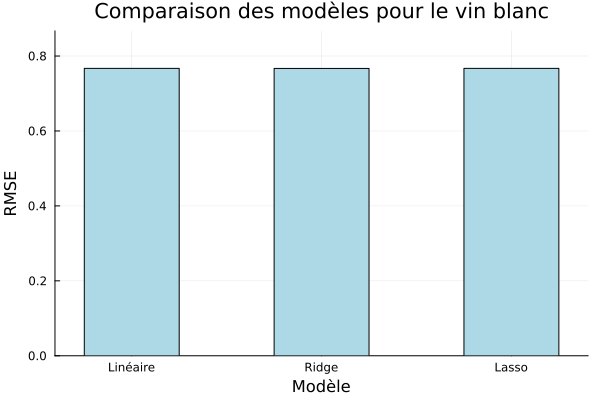

In [126]:
using PrettyTables, DataFrames, Plots

# Données du tableau
model_names = ["Linéaire", "Ridge", "Lasso"]
rmse_vals = round.([eval_lin.measurement[1], eval_ridge.measurement[1], eval_lasso.measurement[1]], digits=4)

# Créer le DataFrame pour le tableau
df_results = DataFrame(Modèle = model_names, RMSE = rmse_vals)

# Afficher le tableau
pretty_table(df_results)

# Créer un graphique à barres
bar(model_names, rmse_vals,
    xlabel = "Modèle",
    ylabel = "RMSE",
    title = "Comparaison des modèles pour le vin blanc",
    legend = false,
    bar_width = 0.5,
    color = [:lightblue :lightgreen :salmon],
    ylim = (0, maximum(rmse_vals) + 0.1))


Comme pour le vin rouge, on peut voir que la régression Ridge et la régression Lasso n'apportent pas davantage de pouvoir prédictif que la régression linéaire.

### 3.1.3 Mélange des modèles

Étant donnée que la régression Lasso et Ridge ne semble pas apporter d'atout majeur au RMSE, nous allons utiliser la régression linéaire simple pour les modèles du vin rouge et du vin blanc.

Nous allons d'abord créer une fonction qui permet de choisir le bon modèle en fonction du type de vin.

In [127]:
function predict_combined(df, mach_red, mach_white, X_wine_names)
    red_idx = findall(row -> row.type == "rouge", eachrow(df))
    white_idx = findall(row -> row.type == "blanc", eachrow(df))

    cols_to_drop = [:sucre_missing, :type]
    if :qualite in names(df)
        push!(cols_to_drop, :qualite)
    end

    X = DataFrames.select(df, Not(cols_to_drop))
    X = X[:, names(X_wine_names)]

    y_pred = Vector{Float64}(undef, nrow(df))
    y_pred[red_idx] = MLJ.unwrap(MLJ.predict(mach_red, X[red_idx, :]))
    y_pred[white_idx] = MLJ.unwrap(MLJ.predict(mach_white, X[white_idx, :]))

    return y_pred
end

predict_combined (generic function with 1 method)

Puis estimer le RMSE total pour les deux types de vin en régression linéaire simple :

In [128]:
y_true = train_imputed.qualite
y_pred = predict_combined(train_imputed, mach_red_lin, mach_white_lin, X_red)

rmse_combined_lin = rms(y_pred, y_true)
println("RMSE combiné = ", rmse_combined_lin)

RMSE combiné = 0.7374893103175616


Le RMSE final obtenu avec les modèles linéaires est d’environ 0.73, ce qui reste relativement élevé et peu prometteur.  
Cela suggère qu’une régression linéaire n’est probablement pas le meilleur choix pour prédire la qualité d’un vin.

Étant donné la nature subjective des évaluations faites par les œnologues, il n’est pas surprenant que les variables chimiques ne soient pas linéairement corrélées à la qualité. De nombreux facteurs, parfois non mesurés, peuvent influencer l’appréciation d’un vin, et il est probable que ces facteurs interagissent de manière non linéaire et complexe.

Nous allons donc explorer des modèles plus avancés, comme les arbres de décision, mieux adaptés à ce type de données. Nous nous concentrerons notamment sur **XGBoost**, un algorithme de gradient boosting reconnu pour ses performances dans ce genre de problématique.

## 3.2 Modèles de régression non linéaire - XGBoost

Le XGBoost est un modèle d'apprentissage machine qui sert à faire des prédictions. Il fonctionne en construisant plusieurs petits arbres de décision, un après l’autre. Chaque nouvel arbre essaie de corriger les erreurs faites par les arbres précédents.

Ce modèle est très populaire parce qu’il est rapide et précis. Il a la capacité à bien gérer des relations complexes entre les variables explicatives, ce qui est notre cas. Il est aussi conçu pour minimiser le surapprentissage, ce qui le rend utile quand on veut faire de bonnes prédictions sur de nouvelles données.


### Principaux hyperparamètres utilisés

- **`eta` (learning rate)** : Contrôle la vitesse d’apprentissage du modèle. Une valeur faible (ex. `0.05`) permet un apprentissage plus progressif, réduisant le risque de surapprentissage. Une valeur plus élevée (ex. `0.1`) accélère l'entraînement ce qui augmente le risque de surapprentissage.
  
- **`max_depth`** : Profondeur maximale des arbres. Plus cette valeur est grande, plus le modèle peut gérer des relations complexes, encore au risque du surapprentissage.

- **`num_round`** : Nombre d’arbres. Plus il y a d’arbres, plus le modèle peut être précis à condition que le taux d’apprentissage soit suffisamment bas.


### 3.2.1 Comparaison des configurations
Nous allons tester les différentes configurations des hyperparamètres du modèle XGBoost pour minimiser le surapprentissage

#### 3.2.1.1 Configuration 1  
Cette configuration mise sur un apprentissage rapide avec une forte capacité de modélisation.

**Hyperparamètres :**  
- **eta = 0.1** : Le modèle apprend plus vite, ce qui peut permettre de converger rapidement vers une solution, mais augmente aussi le risque de surapprentissage.
- **max_depth = 8** : Les arbres sont assez profonds pour modéliser des relations complexes entre les variables.
- **num_round = 300** : On utilise 300 arbres, ce qui permet de contrer la vitessse d'apprentissage (`eta`) élevé.

Cette configuration est puissante sur l’ensemble d’entraînement. Elle permet d'obtenir une meilleur prédiction de la variable cible des résultats, mais il y a une possibilité de surapprentissage pour ce le modèle si les données sont peu nombreuses, car un apprentissage rapide (`eta`) force le modèle à s'ajuster aux données d'entraînement.


In [129]:
model_red1 = XGBoostRegressor(
    eta = 0.1,
    max_depth = 8,
    num_round = 300,
    objective = "reg:squarederror"
)

model_white1 = XGBoostRegressor(
    eta = 0.1,
    max_depth = 8,
    num_round = 300,
    objective = "reg:squarederror"
)

mach_red_XGBoost1 = machine(model_red1, X_red, y_red)
fit!(mach_red_XGBoost1, verbosity=0)

mach_white_XGBoost1 = machine(model_white1, X_white, y_white)
fit!(mach_white_XGBoost1, verbosity=0)

trained Machine; caches model-specific representations of data
  model: XGBoostRegressor(test = 1, …)
  args: 
    1:	Source @584 ⏎ Table{AbstractVector{Continuous}}
    2:	Source @690 ⏎ AbstractVector{Continuous}


In [130]:
y_true = train_imputed.qualite
y_pred = predict_combined(train_imputed, mach_red_XGBoost1, mach_white_XGBoost1, X_red)

rmse_combined_XGBoost1 = rms(y_pred, y_true)
println("RMSE combiné = ", rmse_combined_XGBoost1)

RMSE combiné = 0.0545934243712242


#### 3.2.1.2 Configuration 2
Cette configuration est utilisée pour améliorer la généralisation du modèle aux données en ralentissant l’apprentissage.

**Hyperparamètres :**  

- **eta = 0.05** : Taux d’apprentissage plus bas, donc le modèle progresse plus lentement, ce qui réduit le risque de surapprentissage aux données d’entraînement.
- **max_depth = 8** : Même profondeur que la configuration 1, donc la complexité maximale des arbres reste la même.
- **num_round = 500** : Le nombre d’arbres est plus élevé pour compenser le taux d’apprentissage plus lent. Cela permet au modèle de construire sa solution de manière plus progressive.

Cette configuration permet d'éviter le plus possible le surapprentissage tout en gardant une bonne capacité à modéliser les données. Comparément à la configuration 1, le taux d'apprentissage est plus lent, ce qui laisse plus de temps au modèle de bien s'ajuster aux données d'entraînement, sans trop les mémoriser.

In [131]:
model_red2 = XGBoostRegressor(
    eta = 0.05,
    max_depth = 8,
    num_round = 500,
    objective = "reg:squarederror"
)

model_white2 = XGBoostRegressor(
    eta = 0.05,
    max_depth = 8,
    num_round = 500,
    objective = "reg:squarederror"
)

mach_red_XGBoost2 = machine(model_red2, X_red, y_red)
fit!(mach_red_XGBoost2, verbosity=0)

mach_white_XGBoost2 = machine(model_white2, X_white, y_white)
fit!(mach_white_XGBoost2, verbosity=0)

trained Machine; caches model-specific representations of data
  model: XGBoostRegressor(test = 1, …)
  args: 
    1:	Source @745 ⏎ Table{AbstractVector{Continuous}}
    2:	Source @782 ⏎ AbstractVector{Continuous}


In [132]:
y_true = train_imputed.qualite
y_pred = predict_combined(train_imputed, mach_red_XGBoost2, mach_white_XGBoost2, X_red)

rmse_combined_XGBoost2 = rms(y_pred, y_true)
println("RMSE combiné = ", rmse_combined_XGBoost2)

RMSE combiné = 0.08768989547807758


#### 3.2.1.3 Évaluation par validation croisé à 5-fold

In [133]:
mach_red_config1_copy = machine(model_red1, X_red, y_red)
mach_red_config2_copy = machine(model_red2, X_red, y_red)
mach_white_config1_copy = machine(model_white2, X_white, y_white)
mach_white_config2_copy = machine(model_white2, X_white, y_white)

rmse_red_config1 = Float64[]
rmse_red_config2 = Float64[]
rmse_white_config1 = Float64[]
rmse_white_config2 = Float64[]

n_runs = 5

for i in 1:n_runs
    cv_red_config1 = evaluate!(mach_red_config1_copy, resampling=CV(nfolds=5, shuffle=true), measure=rms, verbosity=0)
    cv_red_config2 = evaluate!(mach_red_config2_copy, resampling=CV(nfolds=5, shuffle=true), measure=rms, verbosity=0)

    cv_white_config1 = evaluate!(mach_white_config1_copy, resampling=CV(nfolds=5, shuffle=true), measure=rms, verbosity=0)
    cv_white_config2 = evaluate!(mach_white_config2_copy, resampling=CV(nfolds=5, shuffle=true), measure=rms, verbosity=0)

    push!(rmse_red_config1, cv_red_config1.measurement[1])
    push!(rmse_red_config2, cv_red_config2.measurement[1])
    push!(rmse_white_config1, cv_white_config1.measurement[1])
    push!(rmse_white_config2, cv_white_config2.measurement[1])
end

mean_eval_red1 = round(mean(rmse_red_config1), digits=4)
mean_eval_red2 = round(mean(rmse_red_config2), digits=4)
mean_eval_white1 = round(mean(rmse_white_config1), digits=4)
mean_eval_white2 = round(mean(rmse_white_config2), digits=4)

df_cv_rmse = DataFrame(
    "Iteration" => [1, 2, 3, 4, 5, "Moyenne"],
    "Vin rouge - Config 1" => [rmse_red_config1; mean_eval_red1],
    "Vin rouge - Config 2" => [rmse_red_config2; mean_eval_red2],
    "Vin blanc - Config 1" => [rmse_white_config1; mean_eval_white1],
    "Vin blanc - Config 2" => [rmse_white_config2; mean_eval_white2]
)

pretty_table(
    df_cv_rmse,
    header = ["Iteration", "Vin rouge - Config 1", "Vin rouge - Config 2", "Vin blanc - Config 1", "Vin blanc - Config 2"],
    tf = tf_unicode_rounded,
    alignment = [:c, :r, :r, :r, :r],
    formatters = (v, i, j) -> (j > 1 && i <= 5) ? string(round(v, digits=4)) : v,
    highlighters = Highlighter((data, i, j) -> i == 6, bold=true)
)

╭───────────┬──────────────────────┬──────────────────────┬──────────────────────┬──────────────────────╮
│ Iteration │ Vin rouge - Config 1 │ Vin rouge - Config 2 │ Vin blanc - Config 1 │ Vin blanc - Config 2 │
├───────────┼──────────────────────┼──────────────────────┼──────────────────────┼──────────────────────┤
│     1     │               0.6405 │               0.6433 │               0.6509 │               0.6483 │
│     2     │               0.6453 │               0.6129 │                0.659 │               0.6537 │
│     3     │               0.6439 │               0.6412 │               0.6572 │               0.6529 │
│     4     │                0.635 │               0.6475 │               0.6553 │                0.651 │
│     5     │               0.6339 │               0.6675 │                0.654 │               0.6606 │
│  Moyenne  │               0.6397 │               0.6425 │               0.6553 │               0.6533 │
╰───────────┴──────────────────────┴──────────

Les résultats obtenus montrent que les deux configurations testées ont des performances très similaires en validation croisée. Cependant, elles ont chacunes des risques différents en termes de précision et de surapprentissage.

#### Risques 

La **configuration 1** atteint un RMSE très bas sur les données d'entraînement, soit environ `0.05`, ce qui indique que le modèle s’adapte extrêmement bien aux données vues. Par contre, son RMSE en validation croisée est plus élevé, ce qui démontre un écart important entre entraînement et validation. Il y a donc risque de surapprentissage.

La **configuration 2**, de son côté, apprend plus lentement (`eta` plus faible), avec un RMSE d'entraînement plus élevé, soit environ `0.08`. Cependant, son RMSE en validation croisée reste presque identique à celui de la configuration 1. Cela montre une meilleure stabilité entre les données vues et les données nouvelles, ce qui réduit le risque de surapprentissage.

#### Configuration 1

La moyenne des RMSE CV est extrêmement proche pour chaque type de vin. Cela démontre que, malgré un apprentissage plus agressif, la configuration 1 est assez stable en validation.

Même si elle présente un risque plus élevé de surapprentissage, les résultats montrent que ce risque n'est pas assez critique pour la laisser de côté. Le modèle ne montre aucune instabilté importante entre les folds, de même qu'il bat légèrement la configuraton 2 sur certaines des itérations.

De plus, le nombre de données est très nombreux, ce qui permet d'atténuer le surapprentisssage du modèle XGBoost. Avec un jeu de données plus grand, le modèle sera entraîné sur plus d'exemple diversifié, ce qui lui permet d’apprendre des relations plus générales et robustes. Cependant, cela ne permet pas de complètement éviter le surapprentissage, un risque dont nous sommes conscients.

Ceci étant dit, il est plus avantageux de retenir le modèle le plus précis.

#### Résumé

Nous avons donc décidé de retenir **la configuration 1** comme modèle final. Elle permet d’atteindre la meilleure précision globale, tout en conservant une généralisation satisfaisante selon la validation croisée. 

On reconnaît qu'il y a risque de surapprentissage, mais cela est justifié par le gain de performance observé sur l’ensemble du projet.


### 3.2.2 Comparaison des modèles XGBoost 
Il est claire que le modèle XGBoost est supérieur aux différentes régressions utilisées précédemment. Dans les deux cas (configuration 1 et configuration 2), on obtient un RMSE plus faible, soit 0.05 ou 0.09, au lieu de 0.73 avec la régression linéaire simple. Cela prouve que les relations non linéaires entre les variables sont bien plus pertinentes à utiliser pour prédire la qualité d’un vin.

## 3.3 Tests avec un modèle polynomiale

Même si nous croyons que le modèle XGBoost est le meilleur choix pour prédire la qualité d’un vin, nous allons tout de même tester un modèle polynomial afin de voir si il y a un gain de performance.

Nous avons créer une fonction qui permet de générer toute les combinaisons de variables explicatives au degré voulu.

In [134]:
function polynomial_expansion(X::DataFrame, degree::Int)
    poly_df = DataFrame()
    n = ncol(X)
    colnames = names(X)

    # Ajouter les colonnes originales
    for name in colnames
        poly_df[!, string(name)] = X[!, name]
    end

    # Ajouter les puissances au carré
    for name in colnames
        col = X[!, name]
        poly_df[!, "$(name)^2"] = col .* col
    end

    # Ajouter les termes d’interaction (i < j)
    for i in 1:n
        for j in (i+1):n
            name_i, name_j = colnames[i], colnames[j]
            poly_df[!, "$(name_i)*$(name_j)"] = X[!, name_i] .* X[!, name_j]
        end
    end

    return poly_df
end

polynomial_expansion (generic function with 1 method)

### 3.3.1 Vins rouges

In [135]:
X_red_poly = polynomial_expansion(X_red, 2)
println("Nombre de features : ", ncol(X_red_poly))

# Standardisation
stand = Standardizer()
mach_stand = machine(stand, X_red_poly)
fit!(mach_stand)
X_red_poly_std = MLJ.transform(mach_stand, X_red_poly);

Nombre de features : 77


[ Info: Training machine(Standardizer(features = Symbol[], …), …).


Il y a maintenant 77 variables explicatives au lieu de 11. Certainement, il y a des variables qui sont redondantes et qui ne sont pas nécessairement pertinentes. Nous allons donc utiliser une régression Ridge.

In [136]:
model = RidgeRegressor()
range_lambda = range(model, :lambda, lower=1e-4, upper=10.0, scale=:log)

tuned_model = TunedModel(
    model = model,
    tuning = Grid(resolution=30),
    resampling = CV(nfolds=5, shuffle=true, rng=1234),
    range = range_lambda,
    measure = rms
)

mach_white = machine(tuned_model, X_red_poly_std, y_red)
fit!(mach_white, verbosity=0)

best_lambda = fitted_params(mach_white).best_model.lambda
println("Meilleur lambda : ", best_lambda)

eval_result = evaluate!(mach_white, resampling=CV(nfolds=5, shuffle=true), measure=rms)
println("RMSE moyen : ", eval_result.measurement[1])

Meilleur lambda : 0.038566204211634744


Evaluating over 5 folds: 100%[=========================] Time: 0:00:00


RMSE moyen : 0.6558092711228907


On remarque alors que le RMSE à très peu diminuer par rapport au modèle sans l'expansion polynomiale. Nous allons tester pour les vins blancs également.

### 3.3.2 Vins blancs

In [137]:
X_white_poly = polynomial_expansion(X_white, 2)
println("Nombre de features : ", ncol(X_white_poly))

# Standardisation
stand = Standardizer()
mach_stand = machine(stand, X_white_poly)
fit!(mach_stand)
X_white_poly_std = MLJ.transform(mach_stand, X_white_poly);

Nombre de features : 77


[ Info: Training machine(Standardizer(features = Symbol[], …), …).


In [138]:
model = RidgeRegressor()
range_lambda = range(model, :lambda, lower=1e-4, upper=10.0, scale=:log)

tuned_model = TunedModel(
    model = model,
    tuning = Grid(resolution=30),
    resampling = CV(nfolds=5, shuffle=true, rng=1234),
    range = range_lambda,
    measure = rms
)

mach_red = machine(tuned_model, X_white_poly_std, y_white)
fit!(mach_red, verbosity=0)

best_lambda = fitted_params(mach_red).best_model.lambda
println("Meilleur lambda : ", best_lambda)

eval_result = evaluate!(mach_red, resampling=CV(nfolds=5, shuffle=true), measure=rms)
println("RMSE moyen : ", eval_result.measurement[1])

Meilleur lambda : 0.08531678524172813


Evaluating over 5 folds: 100%[=========================] Time: 0:00:01


RMSE moyen : 0.7753183937066074


Ce RMSE encore très similaire à celui du modèle de base confirme que l’expansion polynomiale n’apporte pas de gain significatif dans ce cas-ci.

In [139]:
using MLJ

# Prédictions pour vin rouge et vin blanc
y_pred_red = MLJ.predict(mach_red, X_red_poly_std)
y_pred_white = MLJ.predict(mach_white, X_white_poly_std)

# Combiner les vraies valeurs et les prédictions
y_true_combined = vcat(y_red, y_white)
y_pred_combined = vcat(y_pred_red, y_pred_white)

# Calculer le RMSE combiné
rmse_combined_poly = rms(y_pred_combined, y_true_combined)
println("RMSE combiné avec expansion polynomiale = ", round(rmse_combined_poly, digits=4))


RMSE combiné avec expansion polynomiale = 0.7984


### 3.3.3 Résulats du test polynomiale 

Même après la combinaison de variables avec une polynomiale, les performances du modèle restent très proches de celles obtenues avec le modèle linéaire de base. L’ajout de complexité au modèle linéaire n’apporte pas de gain significatif dans notre cas. Le modèle polynomial ne parvient donc pas à surpasser le modèle XGBoost.

## 3.4 Comparaison des modèles

Nous allons maintenant comparer les différents modèles testés, jusqu'à présent, afin de déterminer lequel offre la meilleure prédiction de la qualité des vins. Cette comparaison se basera principalement sur les scores RMSE obtenus sur les données d'entraînement et en validation croisée.

┌────────────┬─────────┐
│     Modèle │    RMSE │
│     String │ Float64 │
├────────────┼─────────┤
│   Linéaire │  0.7375 │
│    XGBoost │  0.0546 │
│ Polynomial │  0.7984 │
└────────────┴─────────┘
┌─────────────────┬────────────────┐
│          Modèle │ RMSE_CV_5folds │
│          String │        Float64 │
├─────────────────┼────────────────┤
│        Linéaire │          0.767 │
│ XGBoost (Rouge) │         0.6397 │
│ XGBoost (Blanc) │         0.6553 │
│      Polynomial │         0.7753 │
└─────────────────┴────────────────┘


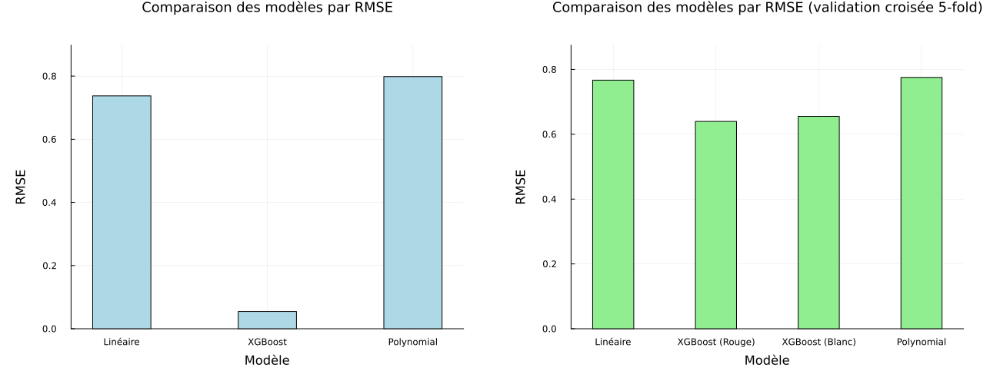

In [140]:
using PrettyTables, DataFrames, Plots

model_names_rmse = ["Linéaire", "XGBoost", "Polynomial"]
model_names_rmse_cv = ["Linéaire", "XGBoost (Rouge)", "XGBoost (Blanc)", "Polynomial"]

rmse_vals = round.([rmse_combined_lin, rmse_combined_XGBoost1, rmse_combined_poly], digits=4)

rmse_cv_vals= [round(eval_lin.measurement[1], digits=4), mean_eval_red1, mean_eval_white1, round(eval_result.measurement[1], digits=4)]

df_rmse = DataFrame(Modèle = model_names_rmse, RMSE = rmse_vals)
pretty_table(df_rmse)

df_rmse_cv = DataFrame(Modèle = model_names_rmse_cv, RMSE_CV_5folds = rmse_cv_vals)
pretty_table(df_rmse_cv)


p1 = bar(model_names_rmse, rmse_vals,
    xlabel = "Modèle",
    ylabel = "RMSE",
    title = "Comparaison des modèles par RMSE",
    legend = false,
    bar_width = 0.4,
    color = :lightblue,
    ylim = (0, maximum(rmse_vals) + 0.1),
    titlefontsize = 12,  
    titlelocation = :center
)

p2 = bar(model_names_rmse_cv, rmse_cv_vals,
    xlabel = "Modèle",
    ylabel = "RMSE",
    title = "Comparaison des modèles par RMSE (validation croisée 5-fold)",
    legend = false,
    bar_width = 0.4,
    color = :lightgreen,
    ylim = (0, maximum(rmse_cv_vals) + 0.1),
    titlefontsize = 12,  
    titlelocation = :center
)

# Afficher les deux graphiques côte à côte
Plots.plot(p1, p2, layout = (1, 2), size = (1300, 500), margin = 10Plots.mm)


On observe que le modèle XGBoost présente une capacité de prédiction bien supérieure à celle des autres modèles. Par conséquent, bien qu'il n'ait pas été présenté explicitement dans le cours, nous avons décidé d’utiliser XGBoost pour effectuer notre soumission. Il s'agit tout de même d’un modèle d’arbre, mais qui applique une technique d’optimisation, gradiant boosting, pour améliorer la performance prédictive tout en réduisant le surapprentissage.

#### Le XGBoost... Pourquoi ?

XGBoost est un algorithme basé sur les arbres de décision et l’optimisation par gradient boosting, ce qui le rend particulièrement efficace pour modéliser des relations complexes et non linéaires entre les variables explicatives et la variable cible. La méthode de gradient boosting permet d'entraîner chaque arbre de décision en fonction de l'erreur quadratique moyenne (MSE). Le modèle cherche a minimiser cette erreur à chaque itération. C'est donc avec un plus grand ensemble de données et des données variées, que le modèle peut offire des meilleurs prédictions.  

Les modèles linéaires, comme la régression linéaire simple ou polynomiale, supposent une relation linéaire entre les variables. Cependant, dans notre cas, comme mentionnée précédemment, il est clair que nous faisons fâce à des relations non linéaires entre les propriétés chimiques du vin (variables explicatives) et la qualité de celui-ci (variable cible).

Bref, le modèle XGBoost surpasse largement les modèles linéaires que nous avons testé, avec un RMSE significativement plus faible. Ce modèle est donc adapté à la subjectivité des différents œnologues que l'on a observé. On peut donc conclure que nous allons utiliser le modèle XGBoost pour la soumission finale. 

# 4. Création d'une soumission

In [141]:
describe(test_imputed)

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Int64,DataType
1,type,,blanc,,rouge,0,"CategoricalValue{String7, UInt32}"
2,alcool,10.4746,8.4,10.2663,14.0,0,Float64
3,sulphites,0.522908,0.25,0.5,1.95,0,Float64
4,pH,3.21911,2.72,3.2,3.9,0,Float64
5,densite,0.99464,0.98746,0.9948,1.0103,0,Float64
6,chlorure,0.05524,0.012,0.047,0.464,0,Float64
7,sucre_residuel,4.86623,0.7,3.1,31.6,0,Float64
8,acide_citrique,0.3132,0.0,0.3,0.91,0,Float64
9,acidite_volatile,0.332035,0.085,0.29,1.13,0,Float64


### 4.1 Avec XGBoost

In [142]:
y_pred = predict_combined(test_imputed, mach_red_XGBoost1, mach_white_XGBoost1, X_red)

1300-element Vector{Float64}:
 5.124173641204834
 5.911737442016602
 5.447459697723389
 5.780606746673584
 6.629478931427002
 5.513425827026367
 5.214038848876953
 5.147441387176514
 5.274101734161377
 5.646861553192139
 6.313291072845459
 5.308508396148682
 6.077960014343262
 ⋮
 4.3066020011901855
 6.012128829956055
 6.195681571960449
 5.374539375305176
 5.000455856323242
 6.168377876281738
 5.970005512237549
 5.139243125915527
 5.494882106781006
 6.0430216789245605
 5.9966888427734375
 5.574501991271973

In [143]:
submission = DataFrame(id = 1:(length(y_pred)), qualite = y_pred)
CSV.write("submission.csv", submission)
n_sub = nrow(submission)

1300

In [144]:
df_test_raw = CSV.read("test.csv", DataFrame)
n_test = nrow(df_test_raw)
println("Nombre de lignes dans test.csv : ", n_test)

Nombre de lignes dans test.csv : 1300


Notre meilleur score obtenu sur Kaggle est de `0.36493`

# 5. Conclusion et améliorations

### Pistes explorées

Dans notre démarche initiale, nous sommes partie avec l'hypothèse que la qualité du vin était quelque peu proportionnelle à ses caractéristiques chimiques de façon linéaire. Dans cette première approche, nous traitions encore l’ensemble du jeu de données comme un tout. Il n'y avait donc pas de séparation par type de vin.

Les performances obtenues de nos modèles n'étaient satisfaisantes. Cependant, notre exploration des données nous a clairement démontré que les vins rouges et blancs ont des distributions très différentes pour plusieurs variables explicatives, comme la densité, l'acidité ou le sucre résiduel.

Cela nous a donc menés à séparer l'ensemble des données d'entraînement en fonction des types de vins et à entraîner les modèle pour chaque groupe.

Cette décision a grandement amélioré les prédictions de la qualité de vin de nos modèles, car elle a permis à chacun d’apprendre des relations spécifiques entre le type de vin et ses caractérisques chimiques. Pour obtenir une prédiction finale, nous avons simplement à faire un mélange des prédictions des deux modèles (rouge et blanc), selon le type du vin dans l’ensemble des données. Pour obtenir une prédiction finale, nous avons simplement combiné les prédictions des deux modèles (rouge et blanc), en fonction du type de vin dans l’ensemble des données. Cette approche mène donc a dire que la densité conditionnelle de la qualité de vin est conditionnelle à son type:

$$
f(y_i \mid \theta_i, z_i) = \begin{cases}
    f_{\text{rouge}}(y_i \mid \theta_i) & \text{si } z_i = "rouge" \\
    f_{\text{blanc}}(y_i \mid \theta_i) & \text{si } z_i = "blanc"
\end{cases}
$$

où \( Z_i \) est la variable observée (non latente) du type de vin et que $\theta_i$ représente les caractéristiques chimiques du vin (densité, acidité, ph, etc.). Cette décision nous permet de tirer parti de relations spécifiques propres aux vins rouges et blancs.

La séparation de l'ensemble des données par type de vin à considérablement amélioré nos résultats. Nous avons donc testé des modèles plus avancés, dont la régression Ridge, Lasso, et la régression polynomiale pour mieux modéliser les relations entre les caractéristiques chimiques du vin et sa qualité. Cependant, les modèles linéaires n'étaient pas capable de bien prédire les relations complexes entre les variables même après avoir séparé les données d'entraînement. Nous étions donc poussé à utiliser une approche plus avancé, ce qui a mené vers le modèle XGBoost. Bien que XGBoost ne soit pas présenté explicitement dans le cours, il s'appuie sur le principe des arbres de décision. Ce modèle nous donné de meilleurs résultats de prédictions comparément aux modèles linéaires.

### Conclusion

En testant différents hyperparamètres, nous obtenu modèle XGBoost optimisé. Nous avons donc décidé de retenir ce modèle pour la soumission finale. En applicant la séparation des donnés par type de vin, XGBoost a offert la meilleure précision globale, tout en ayant une généralisation satisfaisante selon nos tests par validation croisée.

### Améliorations

Bien que nous somme satisfait de nos prédictions, nous avons trouvé quelques pistes à explorer pour améliorer nos résultats:
- Il aurait été intéressant jouer avec les autres hyperparamètres du XGBoost comme `subsample` ou `colsample_bytree`. Ces paramètres auraient permis d’entraîner chaque arbre sur moins de donnés, ce qui nous réduirait le risque de surapprentissage.
- La méthode d'analyse en composantes principales aurait pu être utilisé sur les données d'entraînement. La PCA pourrait permettre de réduire encore plus la multicolinéarité des variables explicatives, ce qui aurait grandement aidé nos modèles de régression linéaire à avoir de meilleurs résultats. 




# 6. Annexe

## 6.1 Autre piste explorée - Filtrage des outliers

Nous avons testé au début de l'analyse si le filtrage des outliers pouvait améliorer la performance du modèle. Cependant, étant donné que le modèle XGBoost est déjà robuste face aux valeurs extrêmes, nous avons décidé de ne pas l'appliquer dans notre soumission finale. Voici tout de même le processus que nous avons suivi pour le filtrage des outliers.

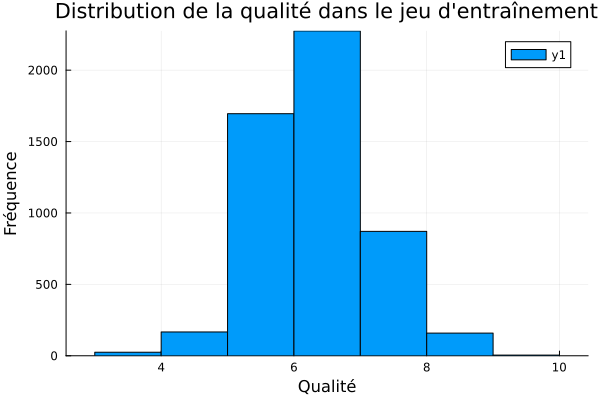

In [72]:
histogram(train_imputed.qualite, bins=10,
    xlabel = "Qualité",
    ylabel = "Fréquence",
    title = "Distribution de la qualité dans le jeu d'entraînement")

In [73]:
function filter_outliers_features(df::DataFrame, target::Symbol; multiplier::Float64 = 1.5)
    mask = trues(nrow(df))
    for col in names(df)
        # On filtre seulement les colonnes qui ne sont pas la variable cible
        if col != target && eltype(df[!, col]) <: Real
            q1 = quantile(df[!, col], 0.25)
            q3 = quantile(df[!, col], 0.75)
            iqr = q3 - q1
            lower_bound = q1 - multiplier * iqr
            upper_bound = q3 + multiplier * iqr
            mask .&= (df[!, col] .>= lower_bound) .& (df[!, col] .<= upper_bound)
        end
    end
    return df[mask, :]
end

# Usage :
println("Nombre de lignes avant filtrage : ", nrow(train_imputed))
data_filtered = filter_outliers_features(train_imputed, :qualite)
println("Nombre de lignes après filtrage des outliers sur features : ", nrow(data_filtered))

Nombre de lignes avant filtrage : 5197
Nombre de lignes après filtrage des outliers sur features : 3724


## 6.2 Autre piste explorée - Model regression bayesian

Nous avons aussi testé un modèle de régression bayésienne comme vu en cours avec comme paramètres X les fonctionnalités présentant la plus forte 
corrélation avec la qualité ("alcool", "densité", "acidité_volatile", "chlorure"). Cependant, étant donné que le modèle XGBoost est déjà robuste 
face aux valeurs extrêmes et que nous avions reçu un score de 0,57, du modèle de régression, lors de la soumission, nous avons décidé de ne pas 
l'appliquer dans notre soumission finale. Voici tout de même le modèle:

Le modèle suivant a obtenu un score de `0.57262` sur Kaggle


In [ ]:
Random.seed!(123)

selected_features = ["alcool", "densite", "acidite_volatile", "chlorure"]

function standardize(x)
    return (x .- mean(x)) ./ std(x)
end

train_std = DataFrame()
for feature in selected_features
    train_std[!, feature] = standardize(train[:, feature])
end

train_std[!, "qualite"] = train.qualite

# Préparer les données de test de la même manière
test_std = DataFrame()
for feature in selected_features
    test_std[!, feature] = standardize(train[:, feature])
end


# Préparer les données pour Turing
X_train = Matrix(train_std[:, selected_features])
y_train = train_std.qualite
X_test = Matrix(test_std[:, selected_features])

@model function bayesian_linear_regression(X, y, ::Type{T}=Float64) where {T}
    # Dimensions
    n, p = size(X)
    
    # Priors pour les coefficients
    α ~ Normal(0, 3)
    β ~ MvNormal(zeros(p), 2 .* ones(p))
    σ ~ InverseGamma(2, 3)
    
    # Vraisemblance
    μ = α .+ X * β
    y ~ MvNormal(μ, σ^2 * I)
end

model = bayesian_linear_regression(X_train, y_train)

# Effectuer l'échantillonnage MCMC (No-U-Turn Sampler)
chain = sample(model, NUTS(0.65), 1000)

display(summarystats(chain))

plot(chain)

# Extraire les paramètres estimés
α_posterior = mean(chain[:α])
β_posterior = [mean(chain[Symbol("β[$i]")]) for i in 1:length(selected_features)]
σ_posterior = mean(chain[:σ])

println("Intercept (α): ", α_posterior)
println("Coefficients (β): ", β_posterior)
println("Écart-type des résidus (σ): ", σ_posterior)

# Effectuer des prédictions sur l'ensemble de test
predictions = α_posterior .+ X_test * β_posterior

LoadError: LoadError: UndefVarError: `@model` not defined in `Main`
Suggestion: check for spelling errors or missing imports.
Hint: a global variable of this name may be made accessible by importing DynamicPPL in the current active module Main
in expression starting at In[79]:28